# $$Deteksi\ Fake\ Follower\ Instagram\ dengan\ Metode\ CatBoost$$

## $$Contents$$
* [1. Data Preparation](#$$1.\-Data\-Preparation$$)
    * [1.1 Catboost Installation](#1.1-Catboost-Installation)
    * [1.2 Data Loading](#1.2-Data-Loading)
    * [1.3 Feature Preparation](#1.3-Feature-Preparation)
    * [1.4 Data Splitting](#1.4-Data-Splitting)
* [2. CatBoost Basics](#$$2.\-CatBoost\-Basics$$)
    * [2.1 Model Training](#2.1-Model-Training)
    * [2.2 Model Cross-Validation](#2.2-Model-Cross-Validation)
    * [2.3 Model Applying](#2.3-Model-Applying)
* [3. CatBoost Features](#$$3.\-CatBoost\-Features$$)
    * [3.1 Using the best model](#3.1-Using-the-best-model)
    * [3.2 Early Stopping](#3.2-Early-Stopping)
    * [3.3 Using Baseline](#3.3-Using-Baseline)
    * [3.4 Snapshot Support](#3.4-Snapshot-Support)
    * [3.5 User Defined Objective Function](#3.5-User-Defined-Objective-Function)
    * [3.6 User Defined Metric Function](#3.6-User-Defined-Metric-Function)
    * [3.7 Staged Predict](#3.7-Staged-Predict)
    * [3.8 Feature Importances](#3.8-Feature-Importances)
    * [3.9 Eval Metrics](#3.9-Eval-Metrics)
    * [3.10 Learning Processes Comparison](#3.10-Learning-Processes-Comparison)
    * [3.11 Model Saving](#3.11-Model-Saving)
    * [3.12 Model Saving](#3.11-Model-Saving)
    * [3.13 Model Saving](#3.11-Model-Saving)
    * [3.14 Model Saving](#3.11-Model-Saving)
    * [3.15 Model Saving](#3.11-Model-Saving)
    * [3.16 Model Saving](#3.11-Model-Saving)
    * [3.17 Model Saving](#3.11-Model-Saving)
    * [3.18 Model Saving](#3.11-Model-Saving)
    * [3.19 Model Saving](#3.11-Model-Saving)
    * [3.20 Model Saving](#3.11-Model-Saving)
* [4. Parameters Tuning](#$$4.\-Parameters\-Tuning$$)

## $$1.\ Data\ Preparation$$
### 1.1 CatBoost installation
Jika belum menginstal CatBoost, kita dapat melakukannya dengan menjalankan perintah '!Pip install catboost'.  
 
Kita juga harus menginstal package ipywidgets dan menjalankan perintah khusus sebelum launching jupyter notebook untuk menggambar plot.

In [1]:
!pip install catboost
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


### 1.2 Data Loading
Dataset yang digunakan dalam penelitian ini adalah dataset yang telah tersedia di https://github.com/fcakyon/instafake-dataset. Dataset tersebut terdiri atas dua buah set yang masing-masing berupa file json, yaitu fake account dan automated account.

Dataset fake account dikumpulkan dari akun instagram dari berbagai negara yang kemudian dilabeli secara manual sehingga terkumpul sebanyak 994 akun real dan 200 akun palsu. Informasi yang tersedia dalam dataset tersebut adalah jumlah follower, jumlah following, jumlah posting-an, akun memiliki foto profil atau tidak, bersifat private atau tidak, jumlah karakter pada biografi akun, jumlah karakter pada username, dan jumlah digit pada username. Dataset ini nantinya akan digunakan dalam mendeteksi fake follower.

In [14]:
# Import module yang dibutuhkan

import os
import re
import json
from json import JSONDecoder
import pandas as pd
import scipy, itertools, matplotlib.pyplot as plt, seaborn as sns, numpy as np
import warnings; warnings.simplefilter('ignore')
from scipy import stats
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import accuracy_score
import numpy as np
np.set_printoptions(precision=4)
import catboost
from catboost import CatBoostClassifier, Pool, cv
from catboost.eval.catboost_evaluation import *
from catboost import *
from catboost import datasets
from catboost.utils import create_cd
from plotly.offline import iplot, init_notebook_mode  # Import plotly untuk menampilkan plot
init_notebook_mode(connected=False)

%matplotlib inline
plt.style.use('bmh'); sns.set()

print('Imported Module')

Imported Module


In [15]:
# Membuat dataframe FakeReal Account

# Buka file json 

with open("FakeReal.json", "r") as file:
    data = json.load(file)
        
dataframe = pd.DataFrame()

for i in data:
    user_follower_count = i["userFollowerCount"]
    user_following_count = i["userFollowingCount"]
    follower_following_ratio = user_follower_count/max(1,user_following_count)
            
    temp_dataframe = pd.Series({"user_media_count":i["userMediaCount"],
                                "user_follower_count":i["userFollowerCount"],
                                "user_following_count":i["userFollowingCount"],
                                "user_has_profil_pic":i["userHasProfilPic"],
                                "user_is_private":i["userIsPrivate"],
                                "follower_following_ratio":follower_following_ratio,
                                "user_biography_length":i["userBiographyLength"],
                                "username_length":i["usernameLength"],
                                "username_digit_count":i["usernameDigitCount"],
                                "is_fake":i["isFake"]
                                })
    
    dataframe = dataframe.append(temp_dataframe, ignore_index=True)

dataframe['user_has_profil_pic'] = dataframe['user_has_profil_pic'].astype('int32')
dataframe['user_is_private'] = dataframe['user_is_private'].astype('int32')
dataframe['is_fake'] = dataframe['is_fake'].astype('int32')
dataframe=dataframe[['is_fake','follower_following_ratio','user_biography_length','user_follower_count','user_following_count','user_has_profil_pic','user_is_private','user_media_count','username_digit_count','username_length']]

cols = list(dataframe.columns.values)
print("jumlah data :", len(dataframe))

jumlah data : 1194


In [57]:
# Menampilkan beberapa data pertama
dataframe.head()

,is_fake,follower_following_ratio,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length
0,1,0.012907,0.0,25.0,1937.0,1,1,0.0,0.0,10.0
1,1,0.078603,0.0,324.0,4122.0,1,0,0.0,4.0,15.0
2,1,0.037594,0.0,15.0,399.0,0,0,0.0,3.0,12.0
3,1,0.130841,0.0,14.0,107.0,1,0,1.0,1.0,10.0
4,1,0.056762,0.0,264.0,4651.0,1,0,0.0,0.0,14.0


In [5]:
# Ukuran Data
N, P = dataframe.shape
print('baris = ', N, ', Kolom = ', P)

dataframe.info()

baris =  1194 , Kolom =  10
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1194 entries, 0 to 1193
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   is_fake                   1194 non-null   int32  
 1   follower_following_ratio  1194 non-null   float64
 2   user_biography_length     1194 non-null   float64
 3   user_follower_count       1194 non-null   float64
 4   user_following_count      1194 non-null   float64
 5   user_has_profil_pic       1194 non-null   int32  
 6   user_is_private           1194 non-null   int32  
 7   user_media_count          1194 non-null   float64
 8   username_digit_count      1194 non-null   float64
 9   username_length           1194 non-null   float64
dtypes: float64(7), int32(3)
memory usage: 79.4 KB


In [6]:
dataframe.columns

Index(['is_fake', 'follower_following_ratio', 'user_biography_length',
       'user_follower_count', 'user_following_count', 'user_has_profil_pic',
       'user_is_private', 'user_media_count', 'username_digit_count',
       'username_length'],
      dtype='object')

Dari info diatas dapat diketahui bahwa dataset memuat 10 variabel, yaitu
1. follower_following_ratio : Perbandingan jumlah follower dengan jumlah following dari setiap akun
2. is_fake : Apakah akun merupakan akun palsu (Bernilai Benar = 1) atau akun asli (Bernilai salah = 0)
3. user_biography_length : Jumlah karakter dalam biografi akun
4. user_follower_count : Jumlah follower dalam setiap akun
5. user_following_count : Jumlah following dalam setiap akun
6. user_has_profil_pic : Apakah akun memiliki foto profil atau tidak
7. user_is_private : Apakah akun bersifat private atau tidak
8. user_media_count : Jumlah postingan yang terdapat dalam setiap akun
9. username_digit_count : Jumlah digit pada username
10. username_length : Jumlah karakter pada username

### 1.3 Feature Preparation

Pertama-tama kita periksa berapa banyak missing value yang kita miliki:

In [16]:
# Mengecek Missing Values
print(dataframe.isnull().sum())

is_fake                     0
follower_following_ratio    0
user_biography_length       0
user_follower_count         0
user_following_count        0
user_has_profil_pic         0
user_is_private             0
user_media_count            0
username_digit_count        0
username_length             0
dtype: int64


Dari output diatas terlihat bahwa tidak terdapat missing value pada setiap variabelnya.

In [118]:
# Membagi menjadi data train dan test

from sklearn.model_selection import train_test_split

train, test = train_test_split(dataframe, test_size = 0.2, random_state=42)

In [10]:
train.head()

,is_fake,follower_following_ratio,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length
728,0,1.006329,16.0,636.0,632.0,1,0,111.0,0.0,5.0
138,1,0.039474,0.0,3.0,76.0,1,1,0.0,2.0,12.0
582,0,0.812000,53.0,203.0,250.0,1,1,131.0,0.0,8.0
667,0,0.980392,0.0,200.0,204.0,1,1,60.0,2.0,16.0
910,0,1.078261,0.0,124.0,115.0,1,0,143.0,0.0,6.0


In [14]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 955 entries, 728 to 1126
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   follower_following_ratio  955 non-null    float64
 1   is_fake                   955 non-null    int32  
 2   user_biography_length     955 non-null    float64
 3   user_follower_count       955 non-null    float64
 4   user_following_count      955 non-null    float64
 5   user_has_profil_pic       955 non-null    int32  
 6   user_is_private           955 non-null    int32  
 7   user_media_count          955 non-null    float64
 8   username_digit_count      955 non-null    float64
 9   username_length           955 non-null    float64
dtypes: float64(7), int32(3)
memory usage: 70.9 KB


In [15]:
test.head()

,follower_following_ratio,is_fake,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length
533,0.595718,0,0.0,473.0,794.0,1,1,4.0,0.0,8.0
618,0.737654,0,106.0,239.0,324.0,1,1,29.0,0.0,10.0
671,0.870833,0,0.0,209.0,240.0,1,0,0.0,0.0,6.0
220,0.688297,0,105.0,594.0,863.0,1,1,276.0,0.0,9.0
58,0.004168,1,0.0,14.0,3359.0,1,0,0.0,1.0,7.0


In [16]:
test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 239 entries, 533 to 76
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   follower_following_ratio  239 non-null    float64
 1   is_fake                   239 non-null    int32  
 2   user_biography_length     239 non-null    float64
 3   user_follower_count       239 non-null    float64
 4   user_following_count      239 non-null    float64
 5   user_has_profil_pic       239 non-null    int32  
 6   user_is_private           239 non-null    int32  
 7   user_media_count          239 non-null    float64
 8   username_digit_count      239 non-null    float64
 9   username_length           239 non-null    float64
dtypes: float64(7), int32(3)
memory usage: 17.7 KB


In [119]:
# Memisahkan fitur(x) dan label(y) 

x = train.drop('is_fake', axis = 1)
y = train.is_fake

x_test = test.drop('is_fake', axis = 1)
y_test = test.is_fake

In [10]:
# Melihat tipe data

print(x.dtypes)

follower_following_ratio    float64
user_biography_length       float64
user_follower_count         float64
user_following_count        float64
user_has_profil_pic           int32
user_is_private               int32
user_media_count            float64
username_digit_count        float64
username_length             float64
dtype: object


Perhatikan bahwa fitur memiliki tipe berbeda. Beberapa di antaranya numerik dan beberapa kategorik. Namun dalam dataset ini fitur kategorik telah diubah menjadi fitur numerik yaitu user_has_profil_pic dan user_is_private. 

Padalah Catboost dapat mempermudah kita dimana fitur dalam bentuk string pun yang biasanya harus ditangani dengan cara tertentu dapat langsung diperlakukan sebagai fitur kategorik. 

In [120]:
# Deklarasi fitur kategorik

cat_features = ['user_has_profil_pic', 'user_is_private']
cat_features

['user_has_profil_pic', 'user_is_private']

In [23]:
# Melihat berapa banyak nilai unik yang dimiliki setiap variabel kategori:

x[cat_features].nunique()

user_has_profil_pic    2
user_is_private        2
dtype: int64

In [24]:
# Melihat keseimbangan label dalam dataset

print('Labels: {}'.format(set(y)))
print('Zero count = {}, One count = {}'.format(len(y) - sum(y), sum(y)))

Labels: {0, 1}
Zero count = 794, One count = 161


In [20]:
# Menyimpan data dalam bentuk file csv

dataset_dir = 'C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal'
if not os.path.exists(dataset_dir):
    os.makedirs(dataset_dir)

# Kita akan dapat bekerja dengan file dengan / tanpa header dan dengan pemisah yang berbeda.

train.to_csv(
    os.path.join(dataset_dir, 'data_train.tsv'),
    index=False, sep='\t', header=False
)
test.to_csv(
    os.path.join(dataset_dir, 'data_test.tsv'),
    index=False, sep='\t', header=False
)

train.to_csv(
    os.path.join(dataset_dir, 'data_train.csv'),
    index=False, sep=',', header=True
)
test.to_csv(
    os.path.join(dataset_dir, 'data_test.csv'),
    index=False, sep=',', header=True
)

In [21]:
# Melihat beberapa data dari file csv yang telah kita simpan

with open('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.csv') as f:
    for _ in range(10): # 10 baris pertama
        print(f.readline())

is_fake,follower_following_ratio,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length

0,1.0063291139240507,16.0,636.0,632.0,1,0,111.0,0.0,5.0

1,0.039473684210526314,0.0,3.0,76.0,1,1,0.0,2.0,12.0

0,0.812,53.0,203.0,250.0,1,1,131.0,0.0,8.0

0,0.9803921568627451,0.0,200.0,204.0,1,1,60.0,2.0,16.0

0,1.0782608695652174,0.0,124.0,115.0,1,0,143.0,0.0,6.0

1,0.07021791767554479,0.0,58.0,826.0,1,0,0.0,4.0,12.0

1,0.7073170731707317,0.0,29.0,41.0,0,1,0.0,0.0,9.0

0,1.5516074450084603,37.0,917.0,591.0,1,1,48.0,0.0,8.0

0,0.2807017543859649,26.0,16.0,57.0,1,1,4.0,2.0,14.0



In [14]:
# Membuat fitur yang mendeskripsikan file (untuk membuat Pool dari dataset)

#feature_names = dict(list(enumerate(train.keys()[1:])))
feature_names = dict()
for column, name in enumerate(train):
    if column == 0:
        continue
    feature_names[column - 1] = name
    
create_cd(
    label=0, 
    cat_features= list(range(5, train.columns.shape[0]-3)),
    feature_names=feature_names,
    output_path=os.path.join(dataset_dir, 'train.cd')
)

In [15]:
!cat $description_file

'cat' is not recognized as an internal or external command,
operable program or batch file.


In [22]:
# Membuat Pool Class
# Kelas ini digunakan sebagai dataset di CatBoost. Bisa juga untuk menggunakan numpy array atau dataframe.
# Akan tetapi menggunakan Pool Class adalah cara paling efisien dalam hal memori dan kecepatan. 
# Sehingga disarankan untuk membuat Pool Class, terutama jika memiliki dataset berukuran besar. 
# Hal ini akan efektif (dalam hal waktu) untuk memuat data dari file, daripada pandas Dataframe.

# Cara 1:
pool1 = Pool(data=x, label=y, cat_features=cat_features) #, has_header=True)

# Cara 2:
pool2 = Pool(
    data=os.path.join(dataset_dir, 'data_train.csv'), 
    delimiter=',', 
    column_description=os.path.join(dataset_dir, 'train.cd'),
    has_header=True
) 

# Cara 3:
pool3 = Pool(data=x, cat_features=cat_features)

# Cara 4
# Cara tercepat untuk membuat Pool Class adalah dengan membuatnya dari matriks numpy.
# Cara ini harus digunakan jika kita ingin prediksi cepat
# atau menginginkan cara tercepat untuk memuat data dengan python.

x_prepared = x.values.astype(str).astype(object)

# Untuk fitur-fitur kategorik, kelas data harus memiliki tipe str

pool4 = Pool(
    data=FeaturesData(
        cat_feature_data=x_prepared,
        cat_feature_names=list(x)
    ),
    label=y.values
)

print('Ukuran Dataset\n')
print('Dataset 1:' + str(pool1.shape) +
      '\nDataset 2:' + str(pool2.shape) + 
      '\nDataset 3:' + str(pool3.shape) +
      '\nDataset 4:' + str(pool4.shape))

print('\n')
print('Nama Kolom\n')
print('Dataset 1:')
print(pool1.get_feature_names()) 
print('\nDataset 2:')
print(pool2.get_feature_names())
print('\nDataset 3:')
print(pool3.get_feature_names())
print('\nDataset 4:')
print(pool4.get_feature_names())

Ukuran Dataset

Dataset 1:(955, 9)
Dataset 2:(955, 9)
Dataset 3:(955, 9)
Dataset 4:(955, 9)


Nama Kolom

Dataset 1:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 2:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 3:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 4:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']


### 1.4 Data Splitting
Membagi data menjadi data train dan data validation

In [174]:
# Jika akan melatih sebuah model, maka kita harus mendeteksi overfitting dan memilih parameter terbaik. 
# Untuk melakukan itu kita perlu memiliki dataset validasi.

from sklearn.model_selection import train_test_split

x_train, x_validation, y_train, y_validation = train_test_split(x, y, train_size=0.8, random_state=42)

train_pool = Pool(data=x_train, label=y_train, cat_features=cat_features)
test_pool = Pool(data=x_test, label=y_test, cat_features=cat_features)
validation_pool = Pool(data=x_validation, label=y_validation, cat_features=cat_features)

print("{:<20} {}".format("Train size:", x_train.shape[0]))
print("{:<20} {}".format("Validation size:", x_validation.shape[0]))
print("{:<20} {}".format("Test size:", x_test.shape[0]))

Train size:          764
Validation size:     191
Test size:           239


## $$2.\ CatBoost\ Basics$$

### 2.1 Model Training
Sekarang kita buat modelnya sendiri. Disini kita akan mencoba menggunakan parameter default karena catboost telah menyediakan baseline yang baik. Hal yang akan kita tentukan di sini adalah parameter `custom_loss`, karena hal tersebut akan membuat kita dapat melihat akurasi serta dapat melihat logloss. Fungsi loss yang kita pilih disini adalah `Logloss`

Logloss biasanya digunakan jika hanya ada dua kemungkinan hasil yang bisa berupa 0 atau 1. Sedangkan cross entropy biasanya digunakan jika ada tiga atau lebih kemungkinan hasil.
Log loss dan cross-entropy sedikit berbeda bergantung pada konteksnya, tetapi dalam pembelajaran mesin saat menghitung tingkat error antara 0 dan 1, keduanya menyelesaikan hal yang sama.

In [27]:
# Melatih Model

model = CatBoostClassifier(
    custom_loss=['Accuracy'],
    loss_function = 'Logloss',
    #loss_function='CrossEntropy',
    random_seed=42,
    logging_level='Silent'         # Untuk menghilangkan keluaran teks, bisa juga dengan menambahkan verbose=False
)

model.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
    plot=True
)

print('Model is fitted: ' + str(model.is_fitted()))
print('Model params:')
print(model.get_params())

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Model is fitted: True
Model params:
{'loss_function': 'Logloss', 'random_seed': 42, 'logging_level': 'Silent', 'custom_loss': ['Accuracy']}


Seperti yang kita lihat bahwa kita dapat melihat pembelajaran model melalui output verbose (teks) atau dengan menggunakan plot (secara pribadi saya memilih menggunakan opsi kedua yaitu cukup dengan memeriksa plot tersebut, dimana salah satu kelebihannya yaitu kita dapat memperbesar area yang kita inginkan)

Dengan ini kita dapat melihat bahwa nilai akurasi terbaik sebesar 0.9843 dicapai pada 5 langkah boosting.

### 2.2 Model Cross-Validation

Menggunakan cross validation untuk validasi model, karena lebih baik serta dapat menampilkan plot.

Fungsi cv CatBoost hanya ditujukan untuk validasi silang (cross-validation), tidak dapat digunakan untuk menyetel parameter sehingga tidak digunakan untuk mendapatkan model dengan parameter terbaik.

Satu-satunya parameter yang dapat dipilih berdasarkan cross-validation adalah jumlah iterasi. Pilih iterasi terbaik berdasarkan informasi dari hasil cv dan latih model akhir dengan jumlah iterasi tersebut.

Dalam hal ini dataset dibagi menjadi N folds. Dimana N – 1 folds digunakan untuk pelatihan dan satu fold digunakan untuk estimasi performa model. Pada setiap iterasi, model dievaluasi pada semua N folds secara independen. Skor rata-rata dengan standar deviasi dihitung untuk setiap iterasi.

In [56]:
# Secara default

cv_params = model.get_params()
cv_params.update({
    'loss_function': 'Logloss'
})
cv_data = cv(
    train_pool,
    cv_params,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [33]:
cv_data.head()

,iterations,test-Logloss-mean,test-Logloss-std,train-Logloss-mean,train-Logloss-std,test-Accuracy-mean,test-Accuracy-std,train-Accuracy-mean,train-Accuracy-std
0,0,0.645343,0.005180,0.643679,0.006589,0.934578,0.019285,0.956796,0.015366
1,1,0.588718,0.004227,0.585851,0.003696,0.950285,0.015780,0.960069,0.014232
2,2,0.543394,0.007041,0.539803,0.005678,0.955493,0.013844,0.960728,0.010408
3,3,0.502033,0.008165,0.497100,0.007052,0.954202,0.012575,0.965967,0.006006
4,4,0.471796,0.007606,0.466314,0.009219,0.945056,0.016983,0.963998,0.012640


Sekarang kita memiliki nilai fungsi kerugian di setiap langkah peningkatan yang dirata-rata sebanyak 3 kali folds, yang seharusnya dapat memberi kita perkiraan yang lebih akurat tentang kinerja model:

In [57]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data['test-Accuracy-mean']),
    cv_data['test-Accuracy-std'][np.argmax(cv_data['test-Accuracy-mean'])],
    np.argmax(cv_data['test-Accuracy-mean'])
))

Best validation accuracy score: 0.97±0.02 pada step 221


In [58]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data['test-Accuracy-mean'])))

Precise validation accuracy score: 0.967283874671916


Seperti yang bisa kita lihat bahwa estimasi awal performa pada single validation fold terlalu optimis. Itulah mengapa cross validation sangat penting.

In [59]:
# Melihat nilai rata-rata dan standar deviasi Logloss untuk cross validation pada iterasi terbaik.

best_value = np.min(cv_data['test-Logloss-mean'])  
best_iter = np.argmin(cv_data['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.0951±0.0497 pada step 161


In [60]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data['test-Logloss-mean'])))

Precise validation Logloss score: 0.09513721629933475


In [61]:
# Mengubah beberapa parameter untuk pelatihan di dalam cv

params1 = {}
params1['loss_function'] = 'Logloss'
params1['custom_loss'] = 'Accuracy', 'AUC'       # Secara default : Accuracy
params1['random_seed'] = 63
params1['learning_rate'] = 0.5

cv_data1 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,                   # Secara default fold_count = 3
    shuffle=True,
    partition_random_seed=0,
    plot=True,
    stratified=False,
    verbose=False
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [42]:
cv_data1.head()

,iterations,test-Logloss-mean,test-Logloss-std,train-Logloss-mean,train-Logloss-std,test-AUC-mean,test-AUC-std
0,0,0.192908,0.014950,0.175666,0.009133,0.978594,0.011166
1,1,0.127494,0.020174,0.096336,0.005149,0.987433,0.004176
2,2,0.113553,0.021156,0.068497,0.006479,0.987704,0.003157
3,3,0.110295,0.031622,0.054336,0.006719,0.989125,0.003888
4,4,0.103483,0.030753,0.046316,0.005762,0.989171,0.003755


In [62]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data1['test-Accuracy-mean']),
    cv_data1['test-Accuracy-std'][np.argmax(cv_data1['test-Accuracy-mean'])],
    np.argmax(cv_data1['test-Accuracy-mean'])
))

Best validation accuracy score: 0.97±0.01 pada step 7


In [63]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data1['test-Accuracy-mean'])))

Precise validation accuracy score: 0.9659786721706226


In [64]:
# Melihat nilai rata-rata dan standar deviasi Logloss untuk cross validation pada iterasi terbaik.

best_value = np.min(cv_data1['test-Logloss-mean'])  
best_iter = np.argmin(cv_data1['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data1['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.1022±0.0325 pada step 5


In [65]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data1['test-Logloss-mean'])))

Precise validation Logloss score: 0.1021798616296293


Parameter berikut menjelaskan cara membagi dataset untuk cross validation:

- `stratified` (True / False)
- `folds` (stratified_shuffle_split / shuffle_split / repeated_split / custom iterator)
- `type` (Classical / Inverted / TimeSeries)

Kita lihat bagaimana menggunakan parameter tersebut.

##### Stratified Cross-validation

Stratified cross validation hanya untuk klasifikasi.
Jika `stratified = True`, setiap fold berisi persentase baris yang sama dari setiap kelas sebagai dataset.
Jika `stratified = False`, folds diambil sampelnya secara seragam.

Biasanya, stratified cross validation memiliki nilai standar deviasi kerugian yang lebih kecil.

In [49]:
# stratified cross-validation dengan parameter yang sama
# Untuk kumpulan data yang tidak seimbang (unbalanced dataset), 
# validasi silang berlapis (stratified cross-validation) dapat berguna

params2 = {}
params2['loss_function'] = 'Logloss'
params2['custom_loss'] = 'Accuracy', 'AUC'       
params2['random_seed'] = 63
params2['learning_rate'] = 0.5

cv_data2 = cv(
    params = params2,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    type = 'Classical',
    shuffle=True,
    partition_random_seed=0,
    plot=True,
    stratified=True,
    verbose=False
)

#print_cv_summary(cv_data2)

best_value = np.min(cv_data2['test-Logloss-mean'])
best_iter = np.argmin(cv_data2['test-Logloss-mean'])

print('Best validation Logloss score, stratified: {:.4f}±{:.4f} on step {}'.format(
    best_value,
    cv_data2['test-Logloss-std'][best_iter],
    best_iter)
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Best validation Logloss score, stratified: 0.1028±0.0260 on step 13


In [66]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data2['test-Accuracy-mean']),
    cv_data2['test-Accuracy-std'][np.argmax(cv_data2['test-Accuracy-mean'])],
    np.argmax(cv_data2['test-Accuracy-mean'])
))

Best validation accuracy score: 0.96±0.02 pada step 16


In [67]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data2['test-Accuracy-mean'])))

Precise validation accuracy score: 0.9647300068352699


In [68]:
best_value = np.min(cv_data2['test-Logloss-mean'])  
best_iter = np.argmin(cv_data2['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data2['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.1028±0.0260 pada step 13


In [69]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data2['test-Logloss-mean'])))

Precise validation Logloss score: 0.1028469340107396


##### Cross validation dengan sklearn folds

Catboost dapat menggunakan sklearn folds: https://scikit-learn.org/stable/modules/classes.html#module-sklearn.model_selection

Terdapat tiga jenis sklearn folds: ShuffleSplit, RepeatedKFold, dan StratifiedShuffleSplit.

Catatan bahwa parameter `stratified` dan` type` diabaikan dalam kasus ini.

#### 1. Random Permutation Cross validator 

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.ShuffleSplit.html#sklearn.model_selection.ShuffleSplit

In [70]:
from sklearn.model_selection import ShuffleSplit

shuffle_split = ShuffleSplit(n_splits=5, test_size=.25, random_state=0)
cv_data3 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    folds = shuffle_split,
    plot=True
)

#print_cv_summary(cv_data3)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

NameError: name 'print_cv_summary' is not defined

#### 2. Repeated K-Fold cross validator

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RepeatedKFold.html#sklearn.model_selection.RepeatedKFold

In [71]:
from sklearn.model_selection import RepeatedKFold

repeated_split = RepeatedKFold(n_splits=5, n_repeats=2, random_state=2652124)
cv_data4 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    plot=True,
    folds = repeated_split
)

#print_cv_summary(cv_data4)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### 3. Stratified ShuffleSplit cross-validator

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedShuffleSplit.html#sklearn.model_selection.StratifiedShuffleSplit

In [72]:
from sklearn.model_selection import StratifiedShuffleSplit

stratified_shuffle_split = StratifiedShuffleSplit(n_splits=5, test_size=0.5, random_state=0)
cv_data5 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    folds = stratified_shuffle_split,
    plot = True
)

#print_cv_summary(cv_data5)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

##### Jenis CatBoost folds

1. Jika `type = 'Classical'`, maka setiap set pengujian terdiri dari satu fold, dan set pelatihan terkait terdiri dari sisa k-1 folds.

In [73]:
params = {}
params['loss_function'] = 'Logloss'
params['custom_loss'] = 'Accuracy'
params['random_seed'] = 63
params['learning_rate'] = 0.5

In [74]:
cv_data6 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'Classical',
    verbose=False
)

#print_cv_summary(cv_data6)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2. Jika `type = 'Inverted'`, maka setiap set pengujian terdiri dari k-1 folds, dan set pelatihan terkait terdiri dari folds yang tersisa.

In [75]:
cv_data7 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'Inverted',
    verbose=False
)

#print_cv_summary(cv_data7)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

3. Jika `type = TimeSeries`, maka setiap set pelatihan terdiri dari k folds pertama, dan set pengujian terkait terdiri dari folds ke-(k + 1).

Biasanya, jenis fold ini mengurangi nilai standar deviasi kerugian, jika urutan baris dalam dataset itu penting.

In [76]:
cv_data8 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'TimeSeries',
    verbose=False
)

#print_cv_summary(cv_data8)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

### 2.3 Model Applying
Ada banyak cara untuk melakukan prediksi.
Yang termudah adalah memanggil predict atau predict_proba.

In [33]:
predictions = model.predict(x_validation)
predictions_probs = model.predict_proba(x_validation)
print(predictions[:10])
print(predictions_probs[:10])

[0 1 0 0 1 1 0 0 0 0]
[[0.995  0.005 ]
 [0.0274 0.9726]
 [0.994  0.006 ]
 [0.994  0.006 ]
 [0.0921 0.9079]
 [0.1243 0.8757]
 [0.9962 0.0038]
 [0.9915 0.0085]
 [0.9722 0.0278]
 [0.9764 0.0236]]


In [34]:
print(model.predict_proba(data=x_validation))

[[0.995  0.005 ]
 [0.0274 0.9726]
 [0.994  0.006 ]
 [0.994  0.006 ]
 [0.0921 0.9079]
 [0.1243 0.8757]
 [0.9962 0.0038]
 [0.9915 0.0085]
 [0.9722 0.0278]
 [0.9764 0.0236]
 [0.9956 0.0044]
 [0.9938 0.0062]
 [0.9942 0.0058]
 [0.9767 0.0233]
 [0.9955 0.0045]
 [0.9772 0.0228]
 [0.9575 0.0425]
 [0.9955 0.0045]
 [0.9946 0.0054]
 [0.9954 0.0046]
 [0.994  0.006 ]
 [0.9948 0.0052]
 [0.9962 0.0038]
 [0.1132 0.8868]
 [0.9886 0.0114]
 [0.9963 0.0037]
 [0.9867 0.0133]
 [0.9857 0.0143]
 [0.9946 0.0054]
 [0.9926 0.0074]
 [0.994  0.006 ]
 [0.1055 0.8945]
 [0.9959 0.0041]
 [0.9959 0.0041]
 [0.9939 0.0061]
 [0.9908 0.0092]
 [0.9937 0.0063]
 [0.9958 0.0042]
 [0.9854 0.0146]
 [0.9961 0.0039]
 [0.9945 0.0055]
 [0.9499 0.0501]
 [0.9904 0.0096]
 [0.9902 0.0098]
 [0.9942 0.0058]
 [0.9939 0.0061]
 [0.9861 0.0139]
 [0.9829 0.0171]
 [0.995  0.005 ]
 [0.9826 0.0174]
 [0.9268 0.0732]
 [0.9947 0.0053]
 [0.0458 0.9542]
 [0.1231 0.8769]
 [0.5535 0.4465]
 [0.9963 0.0037]
 [0.1368 0.8632]
 [0.0585 0.9415]
 [0.9938 0.006

In [41]:
print(model.predict(data=x_validation))

[0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0
 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0
 0 0 0 0 0 0]


Untuk klasifikasi biner nilai yang dihasilkan tidak dalam nilai [0,1]. Nilainya adalah nilai numerik. Sehingga untuk mendapatkan probabilitas dari nilai ini, kita perlu menghitung sigmoid dari nilai tersebut.

In [35]:
raw_pred = model.predict(
    data=x_validation,
    prediction_type='RawFormulaVal'
)
print(raw_pred)

[-5.2837  3.5696 -5.1131 -5.118   2.2878  1.9522 -5.5623 -4.7612 -3.5528
 -3.7227 -5.4188 -5.0823 -5.1456 -3.7352 -5.3965 -3.7564 -3.1141 -5.3936
 -5.2196 -5.3706 -5.1032 -5.261  -5.5591  2.0582 -4.4656 -5.6009 -4.3048
 -4.2361 -5.2143 -4.8967 -5.1063  2.1371 -5.484  -5.4823 -5.1012 -4.6811
 -5.0681 -5.4576 -4.2131 -5.5436 -5.1999 -2.9433 -4.639  -4.6196 -5.1508
 -5.0902 -4.2642 -4.0537 -5.3025 -4.0318 -2.538  -5.2257  3.0358  1.9636
 -0.2149 -5.5893  1.842   2.779  -5.0797 -3.643  -1.4451 -5.0648 -4.3595
 -5.3461 -5.5542 -4.0278 -4.6893 -5.4111 -5.4714 -4.3333 -5.2732 -4.3316
 -5.1894 -4.2717  1.5694 -5.487  -2.7997  2.3525  2.3062 -5.4652 -3.6056
 -4.2743 -4.9412 -4.9874  0.3783 -4.8186 -3.0066 -2.3397 -4.8571  2.4484
 -4.7255 -4.3234 -4.9072 -4.3631 -5.4455 -4.7807 -3.1105  2.5134 -5.3103
 -5.5869 -5.2545 -5.499  -4.2528 -5.0138  2.5936 -2.9666 -5.4297  1.7274
 -5.3939 -5.003  -0.5924  3.2932  1.876  -4.4751  3.1143 -4.8796 -5.5488
 -1.6375 -2.313  -4.7468 -4.8481 -5.4718 -5.2566 -4

In [36]:
from numpy import exp

sigmoid = lambda x: 1 / (1 + exp(-x))

probabilities = sigmoid(raw_pred)

print(probabilities)

[0.005  0.9726 0.006  0.006  0.9079 0.8757 0.0038 0.0085 0.0278 0.0236
 0.0044 0.0062 0.0058 0.0233 0.0045 0.0228 0.0425 0.0045 0.0054 0.0046
 0.006  0.0052 0.0038 0.8868 0.0114 0.0037 0.0133 0.0143 0.0054 0.0074
 0.006  0.8945 0.0041 0.0041 0.0061 0.0092 0.0063 0.0042 0.0146 0.0039
 0.0055 0.0501 0.0096 0.0098 0.0058 0.0061 0.0139 0.0171 0.005  0.0174
 0.0732 0.0053 0.9542 0.8769 0.4465 0.0037 0.8632 0.9415 0.0062 0.0255
 0.1908 0.0063 0.0126 0.0047 0.0039 0.0175 0.0091 0.0044 0.0042 0.013
 0.0051 0.013  0.0055 0.0138 0.8277 0.0041 0.0573 0.9131 0.9094 0.0042
 0.0265 0.0137 0.0071 0.0068 0.5935 0.008  0.0471 0.0879 0.0077 0.9204
 0.0088 0.0131 0.0073 0.0126 0.0043 0.0083 0.0427 0.9251 0.0049 0.0037
 0.0052 0.0041 0.014  0.0066 0.9304 0.049  0.0044 0.8491 0.0045 0.0067
 0.3561 0.9642 0.8671 0.0113 0.9575 0.0075 0.0039 0.1628 0.0901 0.0086
 0.0078 0.0042 0.0052 0.0088 0.0043 0.9519 0.0057 0.9334 0.0133 0.0104
 0.0454 0.0161 0.0062 0.0054 0.7612 0.0044 0.0043 0.0044 0.9604 0.0104
 0.0047

## $$3.\ CatBoost\ Features$$

Kita telah mengetahui pada langkah pembuatan model bahwa kita tidak hanya dapat menentukan parameter `custom_loss` tetapi juga dapat menentukan parameter `random_seed`. Secara default catboost memilih beberapa nilai acak untuk seed:

In [77]:
model_without_seed = CatBoostClassifier(iterations=10, logging_level='Silent')
model_without_seed.fit(x_train, y_train, cat_features=cat_features)

print('Random seed yang ditugaskan untuk model: {}'.format(model_without_seed.random_seed_))

Random seed yang ditugaskan untuk model: 0


In [78]:
# Menentukan beberapa parameter dan membuat Pool. 
# Pool menyimpan semua informasi tentang dataset (fitur, label, indeks fitur kategorik, bobot, dan masih banyak lagi).

params = {
    'iterations': 500,
    'learning_rate': 0.1,
    'eval_metric': 'Accuracy',
    'random_seed': 42,
    'logging_level': 'Silent',
    'use_best_model': False
}
train_pool = Pool(x_train, y_train, cat_features=cat_features)
validation_pool = Pool(x_validation, y_validation, cat_features=cat_features)

### 3.1 Using the best model
Jika kita memiliki dataset validasi, maka akan lebih baik menggunakan parameter `use_best_model` selama pelatihan. Secara default, parameter ini diaktifkan. Jika diaktifkan, ansambel pohon yang dihasilkan menyusut ke iterasi terbaik.

In [83]:
# model dikecilkan menjadi beberapa pohon ketika mendapatkan nilai metrik evaluasi terbaik pada dataset validasi. 
# Secara default, metrik evaluasi adalah metrik yang dioptimalkan. 
# Tetapi kita dapat menetapkan metrik evaluasi ke beberapa metrik lainnya. 
# Dalam contoh metrik evaluasi di bawah ini adalah Akurasi.

# Model tanpa menggunakan parameter use_best_model
# Jika tidak ingin modelnya menyusut

model = CatBoostClassifier(**params)
model.fit(train_pool, eval_set=validation_pool)#, plot=True)


# Model dengan menggunakan parameter use_best_model
best_model_params = params.copy()
best_model_params.update({
    'use_best_model': True
     #use_best_model=False           # Jika tidak ingin modelnya menyusut, maka dapat mengaturnya seperti di samping
})
best_model = CatBoostClassifier(**best_model_params)
best_model.fit(train_pool, eval_set=validation_pool)#, plot=True

print('Simple model validation accuracy: {:.4}'.format(
    accuracy_score(y_validation, model.predict(x_validation))
))
print('')

print('Best model validation accuracy: {:.4}'.format(
    accuracy_score(y_validation, best_model.predict(x_validation))
))

Simple model validation accuracy: 0.9738

Best model validation accuracy: 0.9843


In [84]:
print('Jumlah Pohon: ' + str(best_model.tree_count_))

Tree count: 5


In [86]:
print('Jumlah Pohon: ' + str(model.tree_count_))

Jumlah Pohon: 500


### 3.2 Early Stopping
Jika memiliki dataset validasi, akan selalu lebih mudah dan lebih baik untuk menggunakan penghentian awal (early stopping). Fitur ini mirip dengan fitur best model, namun selain dapat meningkatkan kualitas juga tetap dapat menghemat waktu.

In [101]:
%%time   

model = CatBoostClassifier(**params)  
model.fit(train_pool, eval_set=validation_pool)

UsageError: Can't use statement directly after '%%time'!


In [102]:
%%time

earlystop_params = params.copy()
earlystop_params.update({
    'od_type': 'Iter',
    'od_wait': 40
})
earlystop_model = CatBoostClassifier(**earlystop_params)
earlystop_model.fit(train_pool, eval_set=validation_pool)

Wall time: 175 ms


In [92]:
print('Jumlah Pohon Simple model: {}'.format(model.tree_count_))
print('Akurasi Validasi Simple model: {:.4}'.format(
    accuracy_score(y_validation, model.predict(x_validation))
))
print('')

print('Jumlah Pohon Early-stopped model: {}'.format(earlystop_model.tree_count_))
print('Akurasi Validasi Early-stopped model: {:.4}'.format(
    accuracy_score(y_validation, earlystop_model.predict(x_validation))
))

Jumlah Pohon Simple model: 500
Akurasi Validasi Simple model: 0.9738

Jumlah Pohon Early-stopped model: 45
Akurasi Validasi Early-stopped model: 0.9791


Jadi kita mendapatkan kualitas yang lebih baik dalam waktu yang lebih singkat.

Meskipun seperti yang ditunjukkan sebelumnya, skema validasi sederhana tidak secara tepat mendeskripsikan skor model out-of-train (mungkin bias karena pemisahan dataset), masih bagus untuk melacak dinamika peningkatan model dan dengan demikian seperti yang dapat kita lihat dari contoh ini sebenarnya baik untuk menghentikan proses boosting lebih awal (sebelum overfitting dimulai)

### 3.3 Using Baseline
Hasil pra-training (baseline) dapat digunakan untuk pelatihan.

In [29]:
current_params = params.copy()
current_params.update({
    'iterations': 10
})
model = CatBoostClassifier(**current_params).fit(x_train, y_train, cat_features)

# Mendapatkan baseline (hanya dengan prediction_type='RawFormulaVal')
baseline = model.predict(x_train, prediction_type='RawFormulaVal')
# Fit model baru
model.fit(x_train, y_train, cat_features, baseline=baseline);

### 3.4 Snapshot Support
Di Catboost kita dapat menggunakan snapshot untuk memulihkan pelatihan setelah interruption atau untuk memulai pelatihan dengan hasil sebelumnya.

#### Snapshotting

In [30]:
params_with_snapshot = params.copy()
params_with_snapshot.update({
    'iterations': 5,
    'learning_rate': 0.5,
    'logging_level': 'Verbose'
})
model = CatBoostClassifier(**params_with_snapshot).fit(train_pool, eval_set=validation_pool, save_snapshot=True)
params_with_snapshot.update({
    'iterations': 10,
    'learning_rate': 0.1,
})
model = CatBoostClassifier(**params_with_snapshot).fit(train_pool, eval_set=validation_pool, save_snapshot=True)

0:	learn: 0.9541885	test: 0.9528796	best: 0.9528796 (0)	total: 1.86ms	remaining: 7.44ms
1:	learn: 0.9633508	test: 0.9633508	best: 0.9633508 (1)	total: 3.34ms	remaining: 5.01ms
2:	learn: 0.9659686	test: 0.9633508	best: 0.9633508 (1)	total: 4.91ms	remaining: 3.27ms
3:	learn: 0.9659686	test: 0.9685864	best: 0.9685864 (3)	total: 6.5ms	remaining: 1.62ms
4:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 7.65ms	remaining: 0us

bestTest = 0.9685863874
bestIteration = 3

5:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 10.2ms	remaining: 10.2ms
6:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 12ms	remaining: 6.49ms
7:	learn: 0.9725131	test: 0.9685864	best: 0.9685864 (3)	total: 13.7ms	remaining: 4.04ms
8:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 15.3ms	remaining: 1.91ms
9:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 16.9ms	remaining: 0us

bestTest = 0.9685863874
bestIteration = 3



In [39]:
# Jika kita berlatih untuk waktu yang lama, misalnya selama beberapa jam, maka kita perlu menyimpan snapshot. 
# Jika tidak, maka ketika laptop atau server akan reboot, kita akan kehilangan semua progress. 
# Untuk itu, kita perlu menentukan parameter snapshot_file. 
# Coba jalankan kode di bawah ini dan hentikan kernel setelah beberapa saat, kemudian coba jalankan sel yang sama lagi. 
# Pelatihan akan dimulai dari iterasi ketika pelatihan diinterupsi. 
# Perhatikan bahwa semua file tambahan ditulis secara default ke direktori catboost_info. 
# Ini dapat diubah menggunakan parameter train_dir. Jadi file snapshot akan ada di sana.

# !rm 'catboost_info/snapshot.bkp'
from catboost import CatBoostClassifier
model = CatBoostClassifier(
    iterations=40,
    save_snapshot=True,
    snapshot_file='snapshot.bkp',
    snapshot_interval=1,
    random_seed=43
)
model.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=True
)

Learning rate set to 0.120264
0:	learn: 0.6105008	test: 0.6084394	best: 0.6084394 (0)	total: 2.15ms	remaining: 83.7ms
1:	learn: 0.5463746	test: 0.5423488	best: 0.5423488 (1)	total: 3.85ms	remaining: 73.2ms
2:	learn: 0.4863575	test: 0.4817123	best: 0.4817123 (2)	total: 6.47ms	remaining: 79.9ms
3:	learn: 0.4336671	test: 0.4298800	best: 0.4298800 (3)	total: 7.88ms	remaining: 70.9ms
4:	learn: 0.3937627	test: 0.3914424	best: 0.3914424 (4)	total: 9.39ms	remaining: 65.7ms
5:	learn: 0.3584493	test: 0.3577696	best: 0.3577696 (5)	total: 10.9ms	remaining: 62ms
6:	learn: 0.3266119	test: 0.3244933	best: 0.3244933 (6)	total: 12.4ms	remaining: 58.6ms
7:	learn: 0.2990084	test: 0.2970411	best: 0.2970411 (7)	total: 13.9ms	remaining: 55.6ms
8:	learn: 0.2760728	test: 0.2750617	best: 0.2750617 (8)	total: 15.5ms	remaining: 53.2ms
9:	learn: 0.2568209	test: 0.2556041	best: 0.2556041 (9)	total: 16.9ms	remaining: 50.7ms
10:	learn: 0.2389906	test: 0.2377608	best: 0.2377608 (10)	total: 18.4ms	remaining: 48.6ms
11

### 3.5 User Defined Objective Function
Kita dapat membuat fungsi objektif sendiri. Di bawah ini kita akan membuat sendiri fungsi objektif logloss.

In [103]:
class LoglossObjective(object):
    def calc_ders_range(self, approxes, targets, weights):
        # approxes, targets, weights containers berindeks floats
        # (containers yang dimana hanya memiliki __len__ and __getitem__ defined).
        # parameter weights bisa kosong/tidak ada
        
        # Untuk memahami apa arti parameter ini, asumsikan bahwa 
        # ada subset dari dataset yang saat ini sedang diproses.
        # perkiraan berisi prediksi saat ini untuk subset tersebut.
        # target berisi nilai target yang kita provide dengan dataset.
        
        # Fungsi ini harus mengembalikan daftar pasangan (der1, der2), dimana
        # der1 adalah turunan pertama dari fungsi kerugian(loss function) terkait ke nilai prediksi
        # dan der2 adalah turunan keduanya.
        
        # Dalam kasus ini, logloss didefinisikan dengan rumus berikut:
        # target * log(sigmoid(approx)) + (1 - target) * (1 - sigmoid(approx))
        # dimana sigmoid(x) = 1 / (1 + e^(-x)).
        
        assert len(approxes) == len(targets)
        if weights is not None:
            assert len(weights) == len(approxes)
        
        result = []
        for index in range(len(targets)):
            e = np.exp(approxes[index])
            p = e / (1 + e)
            der1 = (1 - p) if targets[index] > 0.0 else -p
            der2 = -p * (1 - p)

            if weights is not None:
                der1 *= weights[index]
                der2 *= weights[index]

            result.append((der1, der2))
        return result

In [104]:
model = CatBoostClassifier(
    iterations=10,
    random_seed=42, 
    loss_function=LoglossObjective(), 
    eval_metric="Logloss"
)
# Fit model
model.fit(train_pool)

# Hanya prediction_type = 'RawFormulaVal' yang diizinkan dengan custom `loss_function` 
preds_raw = model.predict(x_test, prediction_type='RawFormulaVal')

0:	learn: 0.6717546	total: 12.4ms	remaining: 112ms
1:	learn: 0.6502494	total: 20.1ms	remaining: 80.2ms
2:	learn: 0.6305099	total: 28.2ms	remaining: 65.9ms
3:	learn: 0.6108675	total: 36.6ms	remaining: 54.9ms
4:	learn: 0.5931649	total: 43.6ms	remaining: 43.6ms
5:	learn: 0.5765790	total: 52.3ms	remaining: 34.8ms
6:	learn: 0.5588634	total: 59.9ms	remaining: 25.7ms
7:	learn: 0.5427009	total: 68.5ms	remaining: 17.1ms
8:	learn: 0.5280079	total: 76.2ms	remaining: 8.46ms
9:	learn: 0.5135963	total: 83.7ms	remaining: 0us


### 3.6 User Defined Metric Function
Selain dapat membuat fungsi objektif sendiri, kita juga dapat membuat fungsi metrik sendiri. Di bawah ini kita akan membuat fungsi metrik logloss. Untuk melakukannya, kita harus mengimplementasikan kelas dengan antarmuka khusus (special interfaces).

In [ ]:
# Interface untuk metrik yang ditentukan pengguna (user defined metrics):

class UserDefinedMetric(object):
    def is_max_optimal(self):
        # Returns apakah nilai maksimal metrik lebih baik
        pass

    def evaluate(self, approxes, target, weight):
        # approxes adalah list dari indexed containers
        # (containers hanya memiliki __len__ and __getitem__ defined),
        # satu container per perkiraan dimensi.
        # Setiap container hanya berisi floats.
        # weight adalah container berindeks satu dimensi.
        # target adalah container berindeks satu dimensi.
        
        # parameter weight bisa tidak ada.
        # Returns pair (error, weights sum)
        pass
    
    def get_final_error(self, error, weight):
        # Mengembalikan nilai akhir metrik berdasarkan error dan bobot
        pass

Catboost mempertimbangkan metrik yang ditentukan pengguna untuk berbagai jenis tugas. Dan akan digunakan variabel berikut:
<center>$a$ - approx value</center>
<center>$p$ - probability</center>
<center>$t$ - target</center>
<center>$w$ - weight</center>

Note: Untuk masalah klasifikasi biner, perkiraan tidak sama dengan probabilitas. Probabilitas dihitung dari perkiraan menggunakan fungsi sigmoid.
<h4><center>$p=\frac{1}{1 + e^{-a}}=\frac{e^a}{1 + e^a}$</center></h4>
Sebagai contoh, mari kita ambil metrik Logloss yang ditentukan oleh rumus berikut:
<h4><center>$Logloss_i = -{w_i * (t_i * log(p_i) + (1 - t_i) * log(1 - p_i))}$</center></h4>
<h4><center>$Logloss = \frac{\sum_{i=1}^{N}{Logloss_i}}{\sum_{i=1}^{N}{w_i}}$</center></h4>
Metrik ini memiliki turunan dan dapat digunakan sebagai tujuan (objective). Turunan Logloss untuk objek tunggal ditentukan dengan rumus berikut:
<h4><center>$\frac{\delta(Logloss_i)}{\delta(a)} = w_i * (t_i - p_i)$</center></h4>
<h4><center>$\frac{\delta^2(Logloss_i)}{\delta(a^2)} = -w_i * p_i * (1 - p_i)$</center></h4>
Berikut metrik Logloss yang kita buat:

In [105]:
class LoglossMetric(object):
    def get_final_error(self, error, weight):
        return error / (weight + 1e-38)

    def is_max_optimal(self):
        return False

    def evaluate(self, approxes, target, weight):
        assert len(approxes) == 1
        assert len(target) == len(approxes[0])

        approx = approxes[0]

        error_sum = 0.0
        weight_sum = 0.0

        for i in range(len(approx)):
            e = np.exp(approx[i])
            p = e / (1 + e)
            w = 1.0 if weight is None else weight[i]
            weight_sum += w
            error_sum += -w * (target[i] * np.log(p) + (1 - target[i]) * np.log(1 - p))

        return error_sum, weight_sum

Di bawah ini terdapat contoh pelatihan dengan fungsi Logloss bawaan serta fungsi Logloss dan metrik Logloss yang kita buat sendiri. Seperti yang bisa kita lihat bahwa hasilnya sama.

In [107]:
# import packages yang diperlukan
from catboost import CatBoostClassifier, CatBoostRegressor
import numpy as np
from sklearn.datasets import make_classification, make_regression
from sklearn.model_selection import train_test_split

In [108]:
x, y = make_classification(n_classes=2, random_state=0)
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=0)

In [109]:
model1 = CatBoostClassifier(iterations=10, loss_function='Logloss', eval_metric='Logloss',
                            learning_rate=0.03, bootstrap_type='Bayesian', boost_from_average=False,
                            leaf_estimation_iterations=1, leaf_estimation_method='Gradient')
model1.fit(x_train, y_train, eval_set=(x_test, y_test))

0:	learn: 0.6900380	test: 0.6907175	best: 0.6907175 (0)	total: 2.56ms	remaining: 23.1ms
1:	learn: 0.6866060	test: 0.6873479	best: 0.6873479 (1)	total: 4.13ms	remaining: 16.5ms
2:	learn: 0.6835392	test: 0.6852325	best: 0.6852325 (2)	total: 5.68ms	remaining: 13.3ms
3:	learn: 0.6804590	test: 0.6829075	best: 0.6829075 (3)	total: 7.22ms	remaining: 10.8ms
4:	learn: 0.6776740	test: 0.6816999	best: 0.6816999 (4)	total: 8.79ms	remaining: 8.79ms
5:	learn: 0.6749116	test: 0.6794533	best: 0.6794533 (5)	total: 10.3ms	remaining: 6.89ms
6:	learn: 0.6712701	test: 0.6772634	best: 0.6772634 (6)	total: 11.9ms	remaining: 5.08ms
7:	learn: 0.6681755	test: 0.6747041	best: 0.6747041 (7)	total: 13.4ms	remaining: 3.35ms
8:	learn: 0.6658881	test: 0.6732683	best: 0.6732683 (8)	total: 15.1ms	remaining: 1.68ms
9:	learn: 0.6633931	test: 0.6720979	best: 0.6720979 (9)	total: 16.7ms	remaining: 0us

bestTest = 0.6720978617
bestIteration = 9



In [110]:
model2 = CatBoostClassifier(iterations=10, loss_function=LoglossObjective(), eval_metric=LoglossMetric(), 
                            learning_rate=0.03, bootstrap_type='Bayesian', boost_from_average=False,
                            leaf_estimation_iterations=1, leaf_estimation_method='Gradient')
model2.fit(x_train, y_train, eval_set=(x_test, y_test))

0:	learn: 0.6900380	test: 0.6907175	best: 0.6907175 (0)	total: 3.75ms	remaining: 33.8ms
1:	learn: 0.6866060	test: 0.6873479	best: 0.6873479 (1)	total: 7.39ms	remaining: 29.5ms
2:	learn: 0.6835392	test: 0.6852325	best: 0.6852325 (2)	total: 11ms	remaining: 25.6ms
3:	learn: 0.6804590	test: 0.6829075	best: 0.6829075 (3)	total: 14.5ms	remaining: 21.8ms
4:	learn: 0.6776740	test: 0.6816999	best: 0.6816999 (4)	total: 18.2ms	remaining: 18.2ms
5:	learn: 0.6749116	test: 0.6794533	best: 0.6794533 (5)	total: 21.8ms	remaining: 14.5ms
6:	learn: 0.6712701	test: 0.6772634	best: 0.6772634 (6)	total: 25.4ms	remaining: 10.9ms
7:	learn: 0.6681755	test: 0.6747041	best: 0.6747041 (7)	total: 28.9ms	remaining: 7.24ms
8:	learn: 0.6658881	test: 0.6732683	best: 0.6732683 (8)	total: 32.6ms	remaining: 3.62ms
9:	learn: 0.6633931	test: 0.6720979	best: 0.6720979 (9)	total: 35.6ms	remaining: 0us

bestTest = 0.6720978617
bestIteration = 9



### 3.7 Staged Predict
CatBoost memiliki metode `staged_predict`(prediksi bertahap). Hal ini memungkinkan kita untuk dapat memprediksi secara berulang untuk rentang pohon tertentu. Yaitu ketika kita ingin memiliki prediksi pada setiap objek di setiap iterasi (atau pada setiap iterasi ke-k). Ini dapat digunakan jika kita ingin menghitung nilai dari beberapa metrik khusus menggunakan prediksi.

In [111]:
model = CatBoostClassifier(iterations=10, random_seed=42, logging_level='Silent').fit(train_pool)
ntree_start, ntree_end, eval_period = 3, 9, 2
predictions_iterator = model.staged_predict(validation_pool, 'Probability', ntree_start, ntree_end, eval_period)
for preds, tree_count in zip(predictions_iterator, range(ntree_start, ntree_end, eval_period)):
    print('First class probabilities using the first {} trees: {}'.format(tree_count, preds[:5, 1]))

First class probabilities using the first 3 trees: [0.2706 0.6533 0.2706 0.2706 0.6349]
First class probabilities using the first 5 trees: [0.1731 0.7876 0.1446 0.1727 0.7662]
First class probabilities using the first 7 trees: [0.1019 0.8718 0.0935 0.1228 0.8022]


In [112]:
predictions_gen = model.staged_predict_proba(
    data=x_validation,
    ntree_start=0, 
    ntree_end=5, 
    eval_period=1
)
try:
    for iteration, predictions in enumerate(predictions_gen):
        print('Iteration ' + str(iteration) + ', predictions:')
        print(predictions)
except Exception:
    pass

Iteration 0, predictions:
[[0.7255 0.2745]
 [0.4089 0.5911]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.4174 0.5826]
 [0.4174 0.5826]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.6265 0.3735]
 [0.6265 0.3735]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.6678 0.3322]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.6117 0.3883]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.4426 0.5574]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.6265 0.3735]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.4279 0.5721]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.3353 0.6647]
 [0.3353 0.6647]
 [0.6457 0.3543]
 [0.7255 0.2745]
 [0.3353 0.6647]
 [0.3

### 3.8 Feature Importances
Terkadang sangat penting untuk memahami fitur mana yang memberikan kontribusi terbesar pada hasil akhir. Untuk melakukan hal tersebut, CatBoost memiliki metode `get_feature_importance`. 
Catboost menyediakan beberapa jenis fitur importances. Salah satunya adalah PredictionDiff: Vektor dengan kontribusi setiap fitur ke perbedaan RawFormulaVal untuk setiap pasangan objek.

In [ ]:
# Menemukan pasangan objek dalam grup pertama di pool test yang peringkat modelnya dalam urutan yang salah.

# Menemukan group pertama
group_size = 1
while group_id_test[group_size] == group_id_test[0]:
    group_size += 1

# Memperoleh prediksi
target = y_test[:group_size]
prediction = model.predict(x_test[: group_size], prediction_type='RawFormulaVal')
prediction = zip(prediction, target, range(group_size))

In [ ]:
# menemukan pasangan objek dengan peringkat yang salah

wrong_prediction_idxs = [
    int(np.max([(x[0], x[2]) for x in prediction if x[1] == 0])),
    int(np.min([(x[1], x[2]) for x in prediction if x[1] == 3]))
]
test_pool_slice = X_test[wrong_prediction_idxs]

zip(model.predict(test_pool_slice, prediction_type='RawFormulaVal'), target[wrong_prediction_idxs])

In [ ]:
# Menghitung PredictionDiff untuk dua objek tersebut dan lihat fitur terpenting
# Seperti yang terlihat, mengubah fitur 133 dapat mengubah prediksi model.

prediction_diff = model.get_feature_importance(type='PredictionDiff', data=test_pool_slice, prettified=True)
prediction_diff.head(10)

In [ ]:
model.plot_predictions(
    data=test_pool_slice,
    features_to_change=prediction_diff["Feature Id"][:3],
    plot=True);

Sekarang kita akan belajar bagaimana memahami fitur mana yang paling penting. 
Kita latih model yang tidak menggunakan kombinasi fitur terlebih dahulu.
Untuk melarang kombinasi fitur, kita perlu menggunakan 'max_ctr_complexity = 1'. Ini akan mempercepat banyak pelatihan, akan tetapi dapat mengurangi kualitas yang dihasilkan.

In [122]:
# Model tanpa menggunakan kombinasi fitur

model = CatBoostClassifier(
    iterations=200,
    max_ctr_complexity=1,
    random_seed=42,
    learning_rate=0.03,
)
model.fit(train_pool, verbose=50)

0:	learn: 0.6272347	total: 3.81ms	remaining: 759ms
50:	learn: 0.0715588	total: 123ms	remaining: 359ms
100:	learn: 0.0418143	total: 240ms	remaining: 236ms
150:	learn: 0.0297321	total: 353ms	remaining: 115ms
199:	learn: 0.0225211	total: 466ms	remaining: 0us


In [123]:
# Melihat fitur mana yang paling penting untuk model tanpa kombinasi fitur

model.get_feature_importance(prettified=True)

,Feature Id,Importances
0,follower_following_ratio,27.037433
1,user_media_count,21.107084
2,user_following_count,13.390328
3,user_follower_count,10.520245
4,user_has_profil_pic,7.732147
5,username_length,6.346689
6,user_biography_length,6.026791
7,user_is_private,5.062082
8,username_digit_count,2.777200


In [124]:
# Model dengan menggunakan kombinasi fitur

model = CatBoostClassifier(iterations=200, random_seed=42, logging_level='Silent').fit(train_pool)

feature_importances = model.get_feature_importance(train_pool)
feature_names = x_train.columns

for score, name in sorted(zip(feature_importances, feature_names), reverse=True):
    print('{}: {}'.format(name, score))

follower_following_ratio: 27.190319159209317
user_media_count: 20.711164093377075
user_following_count: 11.286384501024825
user_follower_count: 9.945367504259996
user_has_profil_pic: 8.728279106784523
user_biography_length: 7.00939030717792
username_length: 6.758559588491519
user_is_private: 4.964979980380002
username_digit_count: 3.4055557592948262


Terlihat bahwa fitur **`follower_following_ratio`** dan **`user_media_count`** memiliki pengaruh terbesar terhadap hasil.

### 3.9 Eval Metrics
CatBoost memiliki metode `eval_metrics` untuk dapat menghitung metrik tertentu pada dataset tertentu. Dan tentu saja juga dapat ditampilkan gambarnya.

#### Metrics Calculation and Graph Plotting

##### Tentang AUC

Kurva ROC menunjukkan kemampuan model untuk membedakan antar kelas.

Model yang secara acak menetapkan suatu kelas ke objek adalah pengklasifikasi yang 'buruk' dan memiliki kurva ROC diagonal. Semakin baik pengklasifikasi, maka semakin tinggi kurva ROC. Kurva ROC diplot dengan TPR (True Positive Rate) pada sumbu y terhadap FPR (False Positive Rate) pada sumbu x. Kurva juga dapat diartikan sebagai Sensitivitas dan Spesifisitas model dengan Sensitivity pada sumbu y dan (1-Specificity) pada sumbu x.

Membangun dan memvisualisasikan kurva ROC dapat digunakan untuk mengukur kinerja algoritma klasifikasi dengan batas probabilitas yang berbeda dan memilih batas probabilitas yang diperlukan untuk mencapai false-positive atau false-negative rate yang ditentukan.

AUC adalah Area di Bawah Kurva ROC. AUC = 1 terbaik untuk model yang memberi peringkat semua objek dengan benar (semua objek dengan kelas 1 diberi probabilitas yang lebih tinggi daripada objek kelas 0). AUC untuk pengklasifikasi 'buruk' sama dengan 0,5.

AUC digunakan untuk klasifikasi biner, klasifikasi multikelas, dan masalah peringkat. AUC mengukur proporsi objek yang diurutkan dengan benar dan kemampuan model untuk membedakan kelas.

AUC memiliki properti statistik penting yaitu AUC pengklasifikasi sama dengan probabilitas pengklasifikasi tersebut akan memberi peringkat instans positif yang dipilih secara acak lebih tinggi daripada instans negatif yang dipilih secara acak.


CatBoost mengimplementasikan AUC untuk masalah klasifikasi biner, multiklasifikasi, dan peringkat. AUC digunakan selama pelatihan untuk mendeteksi overfitting dan memilih model terbaik. AUC juga digunakan sebagai metrik untuk evaluasi prediksi dan perbandingan dengan utils.eval_metric.

In [129]:
# Saat bereksperimen dengan Jupyter notebook, kita dapat melihat grafik error yang berbeda selama pelatihan.
# Untuk melakukan itu, gunakan parameter `plot = True`.

from catboost import CatBoostClassifier
model = CatBoostClassifier(
    iterations=50,
    random_seed=63,
    learning_rate=0.5,
    #learning_rate = 0.1,
    #custom_loss=['Accuracy']
    custom_loss=['AUC', 'Accuracy']
)
model.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
    verbose=False,
    #logging_level='Silent',
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### Metric evaluation on a new dataset

Kita juga dapat menghitung metrik langsung setelah pelatihan.

In [130]:
#metrics = model.eval_metrics(data=pool1, metrics=['Logloss','AUC'], plot=True)

model = CatBoostClassifier(
    random_seed=63,
    iterations=200,
    learning_rate=0.03,
)
model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=50
)

0:	learn: 0.6283714	total: 3.4ms	remaining: 677ms
50:	learn: 0.0737725	total: 116ms	remaining: 338ms
100:	learn: 0.0438050	total: 239ms	remaining: 234ms
150:	learn: 0.0319669	total: 351ms	remaining: 114ms
199:	learn: 0.0231935	total: 463ms	remaining: 0us


In [131]:
metrics = model.eval_metrics(
    data=pool1,
    metrics=['Logloss','AUC'],
    ntree_start=0,
    ntree_end=0,
    eval_period=1,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [132]:
print('AUC values:')
print(np.array(metrics['AUC']))

AUC values:
[0.9767 0.985  0.9866 0.9863 0.9903 0.9912 0.9915 0.9925 0.9924 0.993
 0.9927 0.9929 0.9936 0.994  0.9942 0.994  0.9944 0.9946 0.9947 0.9948
 0.9946 0.9947 0.995  0.9951 0.995  0.9951 0.9952 0.9952 0.9953 0.9954
 0.9956 0.9957 0.9958 0.9958 0.9959 0.996  0.9962 0.9962 0.9963 0.9963
 0.9963 0.9963 0.9964 0.9965 0.9965 0.9965 0.9966 0.9966 0.9967 0.9967
 0.9968 0.9969 0.9969 0.9969 0.9969 0.997  0.9971 0.9971 0.9971 0.9971
 0.9971 0.9972 0.9972 0.9972 0.9973 0.9973 0.9973 0.9973 0.9974 0.9974
 0.9974 0.9974 0.9974 0.9974 0.9974 0.9975 0.9975 0.9975 0.9976 0.9976
 0.9978 0.9978 0.9978 0.9978 0.9978 0.9979 0.9979 0.9979 0.9979 0.9979
 0.998  0.998  0.998  0.998  0.9981 0.9981 0.9981 0.9981 0.9982 0.9982
 0.9982 0.9982 0.9983 0.9983 0.9983 0.9983 0.9983 0.9983 0.9984 0.9984
 0.9984 0.9985 0.9985 0.9985 0.9985 0.9985 0.9985 0.9985 0.9985 0.9986
 0.9986 0.9986 0.9986 0.9986 0.9986 0.9987 0.9987 0.9987 0.9987 0.9987
 0.9987 0.9987 0.9988 0.9988 0.9988 0.9988 0.9988 0.9988 0.9989 0.

In [133]:
model = CatBoostClassifier(iterations=50, random_seed=42, logging_level='Silent').fit(train_pool)
eval_metrics = model.eval_metrics(validation_pool, ['AUC'], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [134]:
print(eval_metrics['AUC'][:6])

[0.9761146496815286, 0.9849194454852005, 0.9818284001498688, 0.9902585237916823, 0.9921318846009741, 0.9930685650056201]


### 3.10 Learning Processes Comparison
Kita juga dapat membandingkan proses pembelajaran berbagai model pada satu plot.

In [125]:
model1 = CatBoostClassifier(iterations=10, depth=1, train_dir='model_depth_1/', logging_level='Silent')
model1.fit(train_pool, eval_set=validation_pool)
model2 = CatBoostClassifier(iterations=10, depth=5, train_dir='model_depth_5/', logging_level='Silent')
model2.fit(train_pool, eval_set=validation_pool);

In [126]:
from catboost import MetricVisualizer
widget = MetricVisualizer(['model_depth_1', 'model_depth_5'])
widget.start()

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### Model Comparison

In [127]:
model1 = CatBoostClassifier(
    learning_rate=0.7,
    iterations=100,
    random_seed=0,
    train_dir='learning_rate_0.7'
)

model2 = CatBoostClassifier(
    learning_rate=0.01,
    iterations=100,
    random_seed=0,
    train_dir='learning_rate_0.01'
)
model1.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)
model2.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)

0:	learn: 0.3250551	test: 0.3146847	best: 0.3146847 (0)	total: 1.79ms	remaining: 178ms
10:	learn: 0.0581718	test: 0.0703477	best: 0.0696827 (9)	total: 17ms	remaining: 138ms
20:	learn: 0.0432302	test: 0.0697150	best: 0.0691893 (12)	total: 34.5ms	remaining: 130ms
30:	learn: 0.0338230	test: 0.0706972	best: 0.0684958 (26)	total: 50ms	remaining: 111ms
40:	learn: 0.0235960	test: 0.0652109	best: 0.0652109 (40)	total: 66.5ms	remaining: 95.7ms
50:	learn: 0.0189675	test: 0.0645932	best: 0.0645932 (50)	total: 81.7ms	remaining: 78.5ms
60:	learn: 0.0155233	test: 0.0660731	best: 0.0645932 (50)	total: 99.3ms	remaining: 63.5ms
70:	learn: 0.0131797	test: 0.0658774	best: 0.0638218 (63)	total: 114ms	remaining: 46.7ms
80:	learn: 0.0115639	test: 0.0679555	best: 0.0638218 (63)	total: 129ms	remaining: 30.3ms
90:	learn: 0.0099120	test: 0.0700732	best: 0.0638218 (63)	total: 144ms	remaining: 14.3ms
99:	learn: 0.0092014	test: 0.0707716	best: 0.0638218 (63)	total: 160ms	remaining: 0us

bestTest = 0.06382178747
be

In [128]:
MetricVisualizer(['learning_rate_0.01', 'learning_rate_0.7']).start() 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

### 3.11 Overfitting Detector

In [138]:
# Fitur berguna lain dari CatBoost adalah detektor overfitting. Latih model dengan penghentian awal (early stopping).

model_with_early_stop = CatBoostClassifier(
    eval_metric='AUC',
    iterations=200,
    random_seed=63,
    learning_rate=0.5,
    early_stopping_rounds=20
)
model_with_early_stop.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
    verbose=False,
    #logging_level = 'Silent',
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [141]:
print(model_with_early_stop.tree_count_)

45


### 3.12 Select Decision Boundary

In [151]:
model = CatBoostClassifier(
    random_seed=63,
    iterations=200,
    learning_rate=0.03,
)
model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [143]:
from catboost.utils import get_roc_curve
import sklearn
from sklearn import metrics

eval_pool = Pool(x_validation, y_validation, cat_features=cat_features)
curve = get_roc_curve(model, eval_pool)
(fpr, tpr, thresholds) = curve
roc_auc = sklearn.metrics.auc(fpr, tpr)

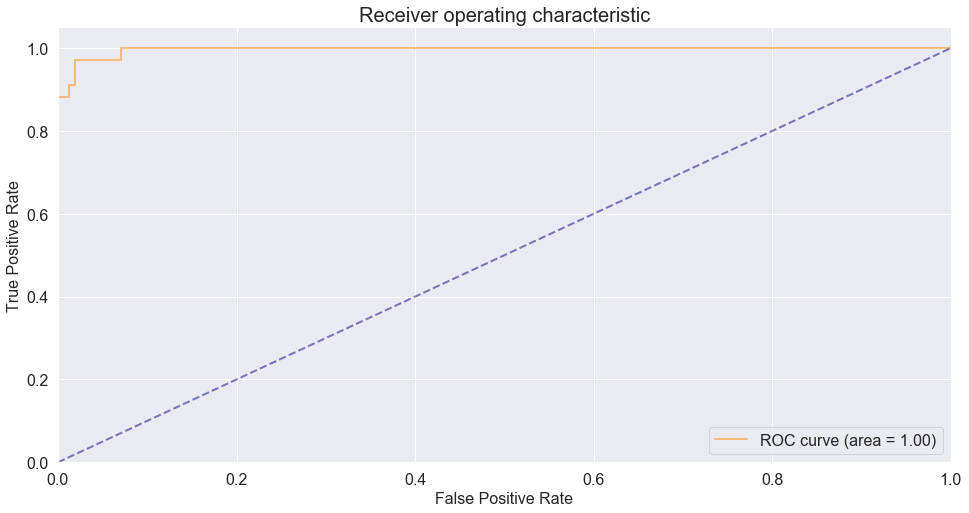

In [144]:
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 8))
lw = 2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver operating characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

In [145]:
from catboost.utils import get_fpr_curve
from catboost.utils import get_fnr_curve

(thresholds, fpr) = get_fpr_curve(curve=curve)
(thresholds, fnr) = get_fnr_curve(curve=curve)

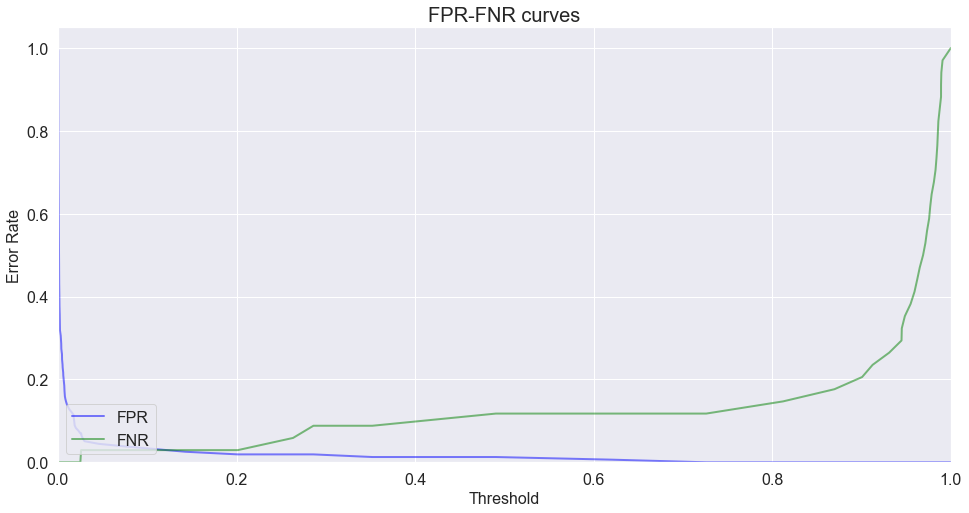

In [146]:
plt.figure(figsize=(16, 8))
lw = 2

plt.plot(thresholds, fpr, color='blue', lw=lw, label='FPR', alpha=0.5)
plt.plot(thresholds, fnr, color='green', lw=lw, label='FNR', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Error Rate', fontsize=16)
plt.title('FPR-FNR curves', fontsize=20)
plt.legend(loc="lower left", fontsize=16)
plt.show()

In [147]:
from catboost.utils import select_threshold

print(select_threshold(model=model, data=eval_pool, FNR=0.01))
print(select_threshold(model=model, data=eval_pool, FPR=0.01))

0.02509089182579458
0.6203015426794639


### 3.13 Randomized Search (Pencarian Acak)
Merupakan bagian dari hyperparameter tuning.

In [159]:
from scipy import stats

class StrangeDistribution:
    def __init__(self, values):
        self.values = values

    def rvs(self):
        return self.values[0]

param_distribution = {
    'one_hot_max_size': stats.bernoulli(p=0.2, loc=2),
    'learning_rate': StrangeDistribution([0.03, 0.1]),
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'depth': stats.binom(n=10, p=0.2)
}

model = CatBoostClassifier(iterations=1000)

randomized_search_results = model.randomized_search(
    param_distribution,
    train_pool,
    n_iter=6,
    shuffle=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 0.1562312453
bestIteration = 145

0:	loss: 0.1562312	best: 0.1562312 (0)	total: 1.42s	remaining: 7.12s

bestTest = 0.1484705741
bestIteration = 84

1:	loss: 0.1484706	best: 0.1484706 (1)	total: 2.87s	remaining: 5.74s

bestTest = 0.1524948663
bestIteration = 138

2:	loss: 0.1524949	best: 0.1484706 (1)	total: 4.13s	remaining: 4.13s

bestTest = 0.1461344566
bestIteration = 131

3:	loss: 0.1461345	best: 0.1461345 (3)	total: 5.32s	remaining: 2.66s

bestTest = 0.4659992681
bestIteration = 94

4:	loss: 0.4659993	best: 0.1461345 (3)	total: 5.84s	remaining: 1.17s

bestTest = 0.1623766998
bestIteration = 196

5:	loss: 0.1623767	best: 0.1461345 (3)	total: 6.77s	remaining: 0us
Estimating final quality...


In [160]:
randomized_search_results['params']

{'l2_leaf_reg': 5,
 'depth': 4.0,
 'one_hot_max_size': 2.0,
 'learning_rate': 0.03}

In [167]:
# Jika search_by_train_test_split = False, 
# maka setiap iterasi pencarian grid mengevaluasi hasil pada cross validation.
# Ngerunnya lama

model1 = CatBoostClassifier(iterations=1000)

randomized_search_results = model1.randomized_search(
    param_distribution,
    train_pool,
    n_iter=6,
    shuffle=False,
    search_by_train_test_split=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	loss: 0.1241176	best: 0.1241176 (0)	total: 1m 51s	remaining: 9m 18s
1:	loss: 0.1241176	best: 0.1241176 (0)	total: 3m 43s	remaining: 7m 26s
2:	loss: 0.1104241	best: 0.1104241 (2)	total: 5m 35s	remaining: 5m 35s
3:	loss: 0.1026505	best: 0.1026505 (3)	total: 7m 26s	remaining: 3m 43s
4:	loss: 0.1041199	best: 0.1026505 (3)	total: 9m 15s	remaining: 1m 51s
5:	loss: 0.1041199	best: 0.1026505 (3)	total: 11m 4s	remaining: 0us


In [168]:
randomized_search_results['params']

{'l2_leaf_reg': 5,
 'depth': 2.0,
 'one_hot_max_size': 2.0,
 'learning_rate': 0.03}

### 3.14 Shap Values

SHAP(SHapley Additive exPlanations) adalah pendekatan teori permainan untuk menjelaskan keluaran dari model pembelajaran mesin apa pun. Ini menghubungkan alokasi kredit yang optimal dengan penjelasan lokal menggunakan nilai Shapley klasik dari teori permainan dan ekstensi terkait (lihat makalah untuk rincian dan kutipan.

In [176]:
# Melatih model lagi
# Library Catboost menyediakan cara untuk memahami fitur mana yang penting untuk objek tertentu. 
# Mari kita lihat seluruh kumpulan data x dan menganalisis pengaruh berbagai fitur pada objek dari kumpulan data ini. 
# Kami akan menghitung kepentingan untuk setiap objek. Setelah itu akan divisualisasikan

model = CatBoostClassifier(iterations=1000)
model.fit(
    train_pool,
    eval_set=validation_pool,
    verbose=False
    #plot=True
)

shap_info = model.get_feature_importance(train_pool, type = 'ShapValues')
expected_value = shap_info[0,-1]
base_values = shap_info[:,-1]
shap_values = shap_info[:,:-1]
print(shap_values.shape)

(764, 9)


In [177]:
# Melihat prediksi model untuk objek ke-0. 
# Prediksi mentah bukanlah probabilitas, 
# untuk menghitung probabilitas dari prediksi mentah kita perlu menghitung sigmoid (raw_prediction).

test_objects = [x_train.iloc[0:1]]

for obj in test_objects:
    print('Probability of class 1 = {:.4f}'.format(model.predict_proba(obj)[0][1]))
    print('Formula raw prediction = {:.4f}'.format(model.predict(obj, prediction_type='RawFormulaVal')[0]))
    print('\n')

Probability of class 1 = 0.0002
Formula raw prediction = -8.7831




In [178]:
# memvisualisasikan penjelasan prediksi pertama
import shap

shap.initjs()
shap.force_plot(expected_value, shap_values[0,:], x_train.iloc[0,:])

Penjelasan di atas menunjukkan fitur yang masing-masing berkontribusi untuk mendorong keluaran model dari nilai dasar (keluaran model rata-rata di atas dataset pelatihan yang kami lewati) ke keluaran model. Fitur yang mendorong prediksi lebih tinggi ditampilkan dengan warna merah, sedangkan fitur yang mendorong prediksi lebih rendah diberi warna biru.

Jika kita mengambil banyak penjelasan seperti yang ditunjukkan di atas, memutarnya 90 derajat, lalu menumpuknya secara horizontal, kita dapat melihat penjelasan untuk seluruh dataset (di notebook plot ini interaktif):

In [179]:
# memvisualisasikan prediksi set pelatihan
shap.force_plot(expected_value, shap_values, x_train)

Untuk memahami bagaimana satu fitur mempengaruhi keluaran model, kita dapat memplot nilai SHAP dari fitur tersebut vs. nilai fitur untuk semua contoh dalam kumpulan data. Karena nilai SHAP mewakili tanggung jawab fitur untuk perubahan dalam keluaran model, plot di bawah ini mewakili perubahan prediksi suatu akun fake atau real berdasarkan follower_following_ratio (Perbandingan jumlah follower dengan jumlah following dari setiap akun). Dispersi vertikal pada nilai tunggal follower_following_ratio menunjukkan efek interaksi dengan fitur lain. Untuk membantu mengungkap interaksi ini, `dependence_plot` secara otomatis memilih fitur lain untuk pewarnaan. Dalam hal ini pewarnaan oleh RAD (indeks aksesibilitas ke jalan raya radial) menyoroti bahwa follower_following_ratio memiliki pengaruh yang lebih kecil terhadap prediksi suatu akun untuk daerah dengan nilai RAD yang tinggi.

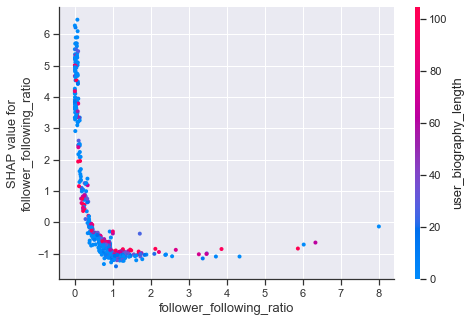

In [180]:
# Membuat plot ketergantungan SHAP untuk menunjukkan efek fitur tunggal di seluruh dataset
shap.dependence_plot("follower_following_ratio", shap_values, x_train)

Jumlah semua nilai shap sama dengan prediksi rumus mentah (raw formula) yang dihasilkan. Dapat dilihat pada grafik di bawah ini bahwa terdapat nilai dasar yang sama untuk semua objek. Dan hampir semua fitur berpengaruh positif terhadap objek ini.

In [181]:
import shap

shap.initjs()
shap.force_plot(base_value=base_values[0], shap_values=shap_values[0], features=x_train.iloc[0])

In [183]:
# fitur terpenting untuk objek ke-3

import shap

shap.initjs()
shap.force_plot(expected_value, shap_values[3,:], x_train.iloc[3,:])

In [184]:
# fitur terpenting untuk objek ke-91

import shap

shap.initjs()
shap.force_plot(expected_value, shap_values[91,:], x_train.iloc[91,:])

Untuk mendapatkan gambaran umum tentang fitur mana yang paling penting untuk model, kita dapat memplot nilai SHAP dari setiap fitur untuk setiap sampel. Plot di bawah mengurutkan fitur berdasarkan jumlah besaran nilai SHAP di semua sampel, dan menggunakan nilai SHAP untuk menunjukkan distribusi dampak yang dimiliki setiap fitur pada keluaran model. Warna mewakili nilai fitur (merah tinggi, biru rendah). Misalnya ini menunjukkan bahwa follower_following_ratio yang tinggi menurunkan prediksi suatu akun.

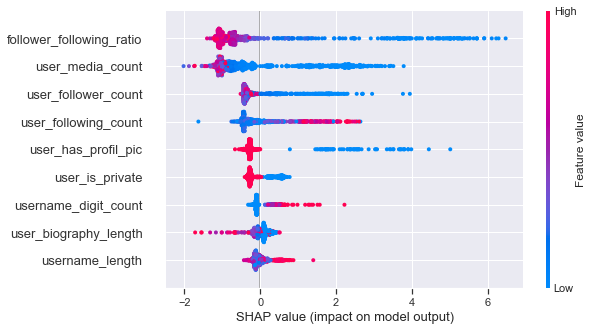

In [185]:
# Melihat informasi gabungan tentang pengaruh pada seluruh dataset.

shap.summary_plot(shap_values, x_train)

Dari grafik di atas kita dapat melihat bahwa nilai fitur follower_following_ratio memiliki pengaruh positif yang besar untuk banyak objek. Selain itu, kita juga dapat melihat bahwa follower_following_ratio memiliki dampak positif terbesar untuk banyak objek.

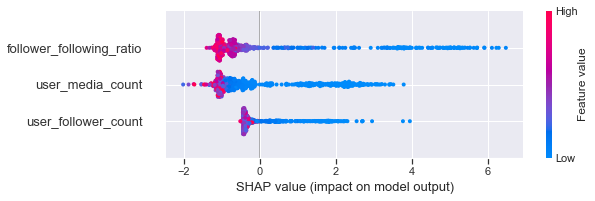

In [187]:
# Anda dapat memilih untuk menampilkan di plot ringkasan hanya fitur yang paling penting.

shap.summary_plot(shap_values, x_train, max_display=3)

In [188]:
# Anda juga dapat menggunakan nilai shap untuk menganalisis pentingnya fitur kategorikal

shap_values = model.get_feature_importance(Pool(x_train, y_train, cat_features=cat_features), type='ShapValues')

expected_value = shap_values[0,-1]
shap_values = shap_values[:,:-1]

Berikut adalah visualisasi pentingnya fitur untuk satu contoh positif dan satu negatif.
Perhatikan, bahwa keluaran klasifikasi biner adalah nilai yang tidak berada dalam rentang `[0,1]`. Anda perlu menghitung nilai fungsi sigmoid, untuk menghitung probabilitas akhir.

In [190]:
test_objects = [x_train.iloc[0:1], x_train.iloc[91:92]]

for obj in test_objects:
    print('Probability of class 1 = {:.4f}'.format(model.predict_proba(obj)[0][1]))
    print('Formula raw prediction = {:.4f}'.format(model.predict(obj, prediction_type='RawFormulaVal')[0]))
    print('\n')

Probability of class 1 = 0.0002
Formula raw prediction = -8.7831


Probability of class 1 = 0.9933
Formula raw prediction = 4.9994




In [191]:
shap.force_plot(expected_value, shap_values[0,:], x_train.iloc[0,:])

In [192]:
shap.force_plot(expected_value, shap_values[91,:], x_train.iloc[91,:])

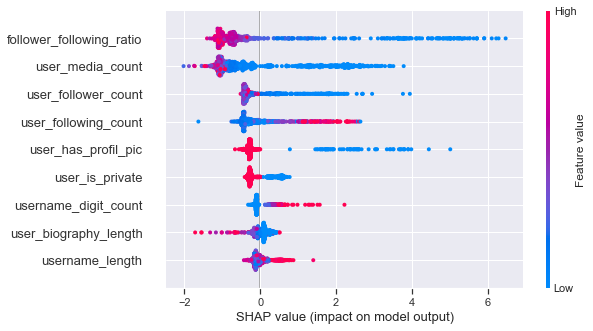

In [193]:
shap.summary_plot(shap_values, x_train)

In [194]:
x_small = x_train.iloc[0:200]
shap_small = shap_values[:200]
shap.force_plot(expected_value, shap_small, x_small)

Ada beberapa tipe kalkulasi yang bisa diatur menggunakan parameter `shap_calc_type` untuk fungsi `get_feature_importance`. Jenis tersebut adalah `Normal` (default), `Approximate` (bekerja lebih cepat, memberikan hasil yang kurang akurat), `Exact` (bekerja lebih lambat, tetapi memungkinkan untuk menghitung hasil yang lebih akurat).

In [195]:
# Evaluasi waktu untuk jenis kalkulasi yang berbeda.
%time approximate = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Approximate")[:, :-1]

Wall time: 52 ms


In [196]:
%time normal = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Regular")[:, :-1]

Wall time: 389 ms


In [197]:
%time exact = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Exact")[:, :-1]

Wall time: 485 ms


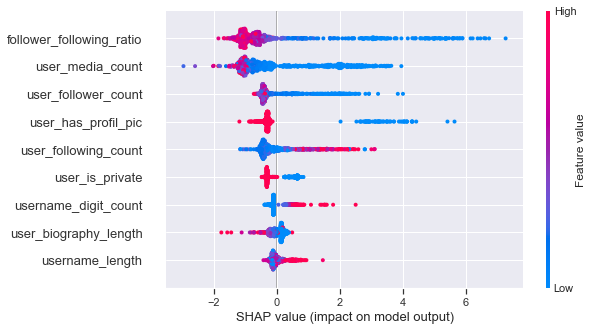

In [198]:
# Plot ringkasan untuk berbagai jenis penghitungan.

shap.summary_plot(approximate, x_train)

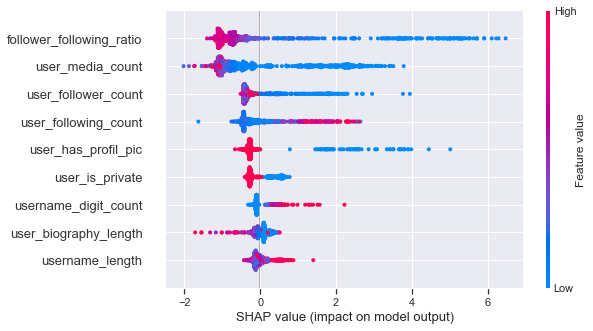

In [199]:
shap.summary_plot(normal, x_train)

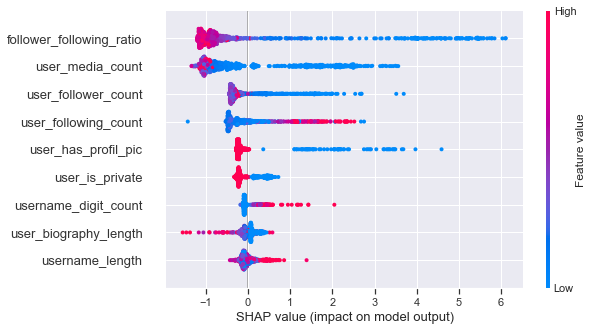

In [200]:
shap.summary_plot(exact, x_train)

### 3.15 Feature Evaluation

Pipeline untuk evaluasi fitur cukup sederhana:
1. Pilih ukuran folds, langkah ini bergantung pada tugas. Harus menggunakan ukuran fold yang akan menjamin sampel representatif dari populasi umum. Disarankan untuk menggunakan maksimal 50% dari dataset sebagai ukuran fold, karena jika tidak, akan lebih mudah untuk overfitting pada semua dataset.
2. Estimasi parameter learning untuk ukuran fold tersebut. Jika memiliki sampel yang representatif, parameter ini harus konsisten untuk folds yang berbeda. Untuk evaluasi fitur, satu tidak perlu menyesuaikan semua parameter, hanya yang utama: kecepatan pembelajaran dan ukuran ensemble.
3. Latih model di setiap fold dan hitung metrik test pada dataset lainnya. Untuk dataset besar, pengujian fold bisa jadi jauh lebih besar daripada learn. Dataset semacam itu seharusnya memberikan hasil yang lebih stabil.

Di sini diasumsikan bahwa kita tahu kecepatan pembelajaran (learning rate) optimal dan ukuran ansambel, nanti akan ditunjukkan, bagaimana kita dapat dengan mudah memperkirakan parameter ini dan menggunakan pustaka ini untuk tugas lain, seperti perbandingan model.

Kita akan menggunakan fold_size 500 dan learning rate 0,5

In [204]:
from catboost.eval.catboost_evaluation import *
from os.path import join

# CatBoost support custom group_column yang dapat digunakan untuk membagi instance untuk belajar / test folds.
# CatboostEvaluation (group_column = id)
# Kolom ini dapat berupa jenis apa pun dalam file cd (misalnya, auxilary)

learn_params = {'iterations': 200, # 1000
                'learning_rate': 0.5, # kita set learning_rate yang besar karena kita memiliki iterasi yang kecil
                'random_seed': 0,
                'verbose': False,
                'loss_function' : 'Logloss',
                'boosting_type': 'Plain',
               # Untuk evaluasi fitur, waktu pembelajaran penting dan hanya membutuhkan kualitas relatif
                'max_ctr_complexity' : 4}

# Membuat objek evaluator
evaluator = CatboostEvaluation('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.tsv',
                               fold_size=500, # <= 50% data dari total dataset
                               fold_count=20,
                               column_description='C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/train.cd',
                               partition_random_seed=0,
                               # working_dir=...   # Direktori kerja, kita perlu membuat file temp selama evaluasi
                               # jadi pastikan kita memiliki ruang kosong yang cukup
                               # Secara default kita akan membuat dir temp unik di direktori temp sistem
                               # group_column = ...# Atur jika memiliki kolom yang akan digunakan untuk split
)

result = evaluator.eval_features(learn_config=learn_params,
                                 eval_metrics=['Logloss', 'Accuracy'],
                                 features_to_eval=[5, 6])  # Cek kualitas dari dua fitur

In [205]:
# Sebagai hasilnya, kita memiliki instance dari objek EvaluationResults. 

from catboost.eval.evaluation_result import *

# Untuk mendapatkan hasil untuk satu metrik perlu memanggil metode get_metric_results
logloss_result = result.get_metric_results('Logloss') 

Baseline case adalah pool tanpa semua fitur yang diuji.
Kasus pengujian bergantung pada EvalType.
Untuk mode SeqAdd kita menguji pool dengan setiap fitur ditambahkan ke pool, sementara yang lain masih diabaikan (forward selection):
Jadi jika kita memiliki mode SeqAdd untuk fitur [0, 1, 2], maka test pools adalah:
1. Pool dengan semua fitur kecuali 0, 1
2. Pool dengan semua fitur kecuali 0, 2
3. Pool dengan semua fitur kecuali 1, 2

Dan baseline pool adalah pool tanpa fitur 0, 1, 2

logloss_result adalah turunan dari kelas MetricEvaluationResult dan berisi semua informasi tentang satu metrik. Biasanya kita hanya perlu memanggil 3 metode. Yang pertama adalah get_baseline_comparision - membuat tabel dengan hasil evaluasi.

In [206]:
#logloss_result.get_baseline_comparison()   # membuat tabel dengan hasil evaluasi
logloss_result.get_baseline_comparison(
    ScoreConfig(ScoreType.Rel, overfit_iterations_info=False)
)

,PValue,Score,Quantile 0.005,Quantile 0.995,Decision
Features: 6,0.000120,14.405057,9.219344,19.793706,GOOD
Features: 5,0.278965,-3.788830,-10.006832,2.093444,UNKNOWN


Dalam tabel untuk setiap kasus pengujian (Pool tanpa beberapa fitur) menunjukkan skor yang dapat dibaca manusia (dapat dikonfigurasi oleh parameter ScoreConfig, secara default kita menggunakan (baseline_score - test_score) * magic_multiplier / baseline_score sebagai skor dalam satu fold. Skor tabel adalah rata-rata skor untuk semua folds. Skor lebih besar berarti kualitas fitur tersebut lebih baik).

Entri tabel terpenting: Decision. Jika ada UNKNOWN atau BAD, maka fitur ini tidak memberikan keuntungan apapun atau tidak memiliki cukup data untuk melihat peningkatan kualitas dari fitur ini.

Jika Decision GOOD, maka fitur memberikan keuntungan.

Namun perlu diketahui, jika overfit iter diff besar, maka bisa jadi penjelasan untuk semua keuntungan (profit) yang kita lihat

Metode berguna kedua yaitu create_fold_learning_curve untuk membuat plotly plot pada fold yang dipilih

In [207]:
iplot(logloss_result.create_fold_learning_curves(0))

In [208]:
baseline_case = logloss_result.get_baseline_case()
baseline_case

Features: None

In [209]:
baseline_result = logloss_result.get_case_result(baseline_case)

In [210]:
iplot(baseline_result.create_learning_curves_plot())

#### Memilih learning rate

Menunjukkan bagaimana menggunakan library untuk tugas lain. Misalnya, mencari kecepatan pembelajaran (learning rate). Untuk ini kita hanya perlu menyesuaikan model dengan learning rate berbeda dan ukuran ansambel tetap dan melihat kurva pembelajaran.

In [211]:
learning_rate_params = learn_params

In [212]:
baseline_case = ExecutionCase(label="Step {}".format(0.03),
                              params=learning_rate_params, 
                              learning_rate=0.03)

In [213]:
other_learning_rate_cases = [ExecutionCase(label="Step {}".format(step), 
                                           params=learning_rate_params, 
                                           learning_rate=step) for step in [0.05, 0.015]]

In [214]:
evaluator = CatboostEvaluation('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.tsv',
                               fold_size=500, # <= 50% data dari total dataset
                               fold_count=1,  # Untuk estimasi learning rate kita hanya membutuhkan 1 fold
                               column_description='C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/train.cd',
                               partition_random_seed=0,
)


In [215]:
evaluator.get_working_dir()

'C:\\Users\\DELLLA~1\\AppData\\Local\\Temp\\tmpmbrp88bq'

In [216]:
learning_rates_result = evaluator.eval_cases(baseline_case, 
                                             other_learning_rate_cases,
                                             eval_metrics="Logloss")

In [217]:
# Hasilnyaaa

logloss_learning_rate_search_results = learning_rates_result.get_metric_results("Logloss")

In [218]:
# Melihat kurva

tmp = logloss_learning_rate_search_results.create_fold_learning_curves(fold=0, offset=200)
iplot(tmp)

Jadi kecepatan pemelajaran default (0,03) sepertinya bagus

### 3.16 Tree Visualization

Cari tahu dulu!!!

In [219]:
# Membuat dan fit model CatBoost dengan pohon kedalaman 2.

model = CatBoostClassifier(depth=2, verbose=False, iterations=10).fit(x_train, y_train)

Saat ini hanya pohon simetris yang dapat divisualisasikan.

Mari pertimbangkan pohon keputusan simetris. Dalam pohon seperti itu, hanya satu fitur yang digunakan untuk membangun semua split di setiap tingkat pohon. Ada tiga jenis split: "FloatFeature", "OneHotFeature", dan "OnlineCtr". Model tanpa fitur kategoris hanya berisi pemisahan "FloatFeature".

Dalam pohon yang divisualisasikan, setiap node mewakili satu split. Karena ada tiga jenis split, maka ada tiga jenis simpul pohon.

Jika model tidak memiliki fitur kategorikal, jadi hanya ada node "FloatFeature" di pohon yang divisualisasikan. Node yang sesuai dengan split "FloatFeature" berisi indeks fitur dan nilai batas, yang digunakan untuk memisahkan objek.

Dalam contoh ini, simpul kedalaman 0 menunjukkan bahwa objek dipisahkan oleh fitur ke-0 dengan nilai batas 393.795. Secara analogi, node dengan kedalaman 1 memisahkan objek dengan fitur ke-2 dengan nilai batas 279.5.

Parameter "pool" adalah opsional untuk model tanpa satu fitur hot. Fitur diberi label dengan indeks eksternalnya dari fitur nama atau pool jika pool disediakan, jika tidak, indeks internal digunakan. Untuk pool yang dipisahkan titik koma (semicolon-separated pool) dengan 2 fitur "f1; label; f2", indeks fitur eksternal adalah 0 dan 2, indeks internal masing-masing adalah 0 dan 1.

##### OneHotFeature

Dengan menggunakan dataset yang berisi data kategorikal.

In [224]:
model = CatBoostClassifier(
    max_depth=2, verbose=False, max_ctr_complexity=1, random_seed=42, iterations=2).fit(train_pool)

model.plot_tree(
    tree_idx=0,
    pool=pool     # "pool" adalah parameter wajib untuk pohon dengan satu fitur hot
)

ExecutableNotFound: failed to execute ['dot', '-Tsvg'], make sure the Graphviz executables are on your systems' PATH

Pohon pertama hanya berisi satu split yang dibuat oleh "OneHotFeature" Sex. Split ini menempatkan objek dengan Sex = female ke kiri dan objek lainnya ke kanan.

##### OnlineCtr features

Melihat pohon lain yang berisi split "OnlineCtr".

In [ ]:
model.plot_tree(tree_idx=1, pool=pool)

Node dengan kedalaman 0 yang sesuai dengan split "OnlineCtr". Split ini dibuat oleh satu fitur : Pclass

In [ ]:
model = CatBoostRegressor(iterations=2, depth=1, boost_from_average=False)

features = [
    [1, 2, 3], 
    [4, 5, 6],
    [7, 8, 9]
]
labels = [1, 0, 1]

model.fit(features, labels, verbose=False);

In [ ]:
# Sel ini tidak berfungsi tanpa graphviz package
# Anda dapat menginstalnya melalui tautan https://graphviz.gitlab.io/download/
# Pemasangan dapat memakan banyak waktu.

from IPython.display import display

display(model.plot_tree(0))
display(model.plot_tree(1))

In [ ]:
x = [0, 7, 2]

raw_pred = model.predict([x])
print(raw_pred)

### 3.17 Grow Policy

Cari tahu dulu!!!

In [ ]:
model = CatBoostRegressor(iterations=2, depth=4, grow_policy='Depthwise')
model.fit(features, labels, verbose=False);
display(model.plot_tree(0))

In [ ]:
model = CatBoostRegressor(iterations=2, max_leaves=16, grow_policy='Lossguide')
model.fit(features, labels, verbose=False);
display(model.plot_tree(0))

### 3.18 CatBoost Partial Dependence Plot (PDP)

Plot ketergantungan parsial dapat menunjukkan sifat hubungan antara target dan fitur, baik linier, monotonik, atau lebih kompleks.

In [ ]:
# Plot PDP pada beberapa dataset
train, _ = datasets.higgs()
X, y = np.array(train.drop(0, axis=1))[:1000], np.array(train[0])[:1000]
pool = Pool(X, y)

# Latih model
cb = CatBoost({'iterations': 50, 'verbose': False, 'random_seed': 42})
cb.fit(pool);

# pilih satu fitur dan plot PDP-nya:
features = 1

_ = cb.plot_partial_dependence(pool, features)

In [ ]:
# plot PDP untuk dua fitur sekaligus. Plot garis sederhana dan mendapatkan heatmap 2d:

features = [1, 2]

_ = cb.plot_partial_dependence(pool, features)

### 3.19 Stdout of The Training

In [ ]:
# Kita dapat melihat nilai stdout dari fungsi loss pada setiap iterasi, atau pada setiap iterasi ke-k.
# Selain itu, juga dapat melihat berapa lama waktu sejak dimulainya pelatihan dan berapa banyak waktu yang tersisa.

from catboost import CatBoostClassifier
model = CatBoostClassifier(
    iterations=15,
    #verbose=5 # Hanya menampilkan iterasi setiap pengulangan 5 saja
)

model.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
)

In [ ]:
# Jika tidak menentukan random_seed maka benih acak (random seed) akan disetel ke nilai baru setiap saat.
# Setelah pelatihan selesai kita dapat melihat nilai dari benih acak yang telah ditetapkan.
# Jika kita latih lagi dengan random_seed, maka tetap akan mendapatkan hasil yang sama.

random_seed = model.random_seed_
print('Used random seed = ' + str(random_seed))
model = CatBoostClassifier(
    iterations=15,
    random_seed=random_seed
)
model.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
)

### 3.20 Model Saving 

Selalu sangat berguna untuk dapat menyimpan model kita ke disk (terutama jika pelatihan membutuhkan waktu).

Kita dapat menyimpan model sebagai file biner. Dimungkinkan juga untuk menyimpan model sebagai kode Python atau C ++. Jika menyimpan model sebagai file biner, maka kita dapat melihat parameter yang digunakan untuk melatih model, termasuk learning_rate dan random_seed yang disetel secara otomatis jika tidak ditentukan.

In [ ]:
model = CatBoostClassifier(iterations=10, random_seed=42, logging_level='Silent').fit(train_pool)
model.save_model('catboost_model.dump')
model = CatBoostClassifier()
model.load_model('catboost_model.dump');

In [89]:
my_best_model = CatBoostClassifier(iterations=10)
my_best_model.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=False
)
my_best_model.save_model('catboost_model.bin')

In [90]:
my_best_model.load_model('catboost_model.bin')
print(my_best_model.get_params())
print(my_best_model.random_seed_)
print(my_best_model.learning_rate_)

{'iterations': 10, 'loss_function': 'Logloss', 'verbose': 0}
0
0.2198030055


##### CatBoost JSON model

CatBoost mendukung ekspor model ke format JSON dan memuat model darinya.

In [ ]:
# Save model JSON ke file

my_best_model.save_model(
    'catboost_model.json', 
    format='json'
    # pool = pool  # parameter ini diperlukan hanya untuk model dengan fitur kategoris.
)

In [ ]:
# Memuat model dari file sebagai JSON dan menunjukkan keys. Model json berisi model_info, oblivious_trees dan features_info. 
# Model dengan fitur kategoris juga akan berisi ctrs

import json

model = json.load(open('catboost_model.json', 'r'))
model.keys()

In [ ]:
# model['model_info'] adalah analog untuk fungsi get_metadata ().
# Kita dapat melihat parameter pelatihan yang digunakan untuk melatih model atau pada versi catboost yang digunakan model tersebut.

print(model['model_info']['catboost_version_info'])

In [ ]:
# Melihat nilai features_info
# Ini bisa berisi 𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒𝑠, 𝑐𝑎𝑡𝑒𝑔𝑜𝑟𝑖𝑐𝑎𝑙_𝑓𝑒𝑎𝑡𝑢𝑟𝑒𝑠 dan 𝑐𝑡𝑟𝑠, yang merupakan daftar deskripsi dari beberapa fitur.

model['features_info'].keys()

Pada kasus model tanpa fitur kategorik hanya ada satu field yaitu 𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒𝑠.

Setiap fitur float dijelaskan dengan cara berikut: __flat_feature_index__ (int) - indeks fitur dalam pool, indeksasi berbasis nol

__feature_index__ (int) indeks diantara fitur float saja, indeksasi berbasis nol. Misalnya, dalam dataset yang terlihat seperti [float, categ, float], fitur float kedua memiliki indeks __𝑓𝑙𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒_𝑖𝑛𝑑𝑒𝑥 = 2__ dan __𝑓𝑒𝑎𝑡𝑢𝑟𝑒_𝑖𝑛𝑑𝑒𝑥 = 1__. Karena ini adalah fitur 2 dari semua dalam indeksasi berbasis 0 dan fitur 1 numerik (di sini kami mengecualikan fitur kategorik). Untuk model tanpa fitur kategorik __𝑓𝑒𝑎𝑡𝑢𝑟𝑒_𝑖𝑛𝑑𝑒𝑥___ akan sama dengan __𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒_𝑖𝑛𝑑𝑒𝑥__ untuk setiap fitur.

__borders__ (daftar semua border (atau split) yang digunakan dalam model untuk fitur float khusus ini). Nilai fitur float dapat dipisahkan dengan nilai __𝑏𝑜𝑟𝑑𝑒𝑟__. Semua elemen dengan nilai fitur __> 𝑏𝑜𝑟𝑑𝑒𝑟__ pergi ke subtree kiri, dan semua elemen dengan elemen nilai fitur __<= 𝑏𝑜𝑟𝑑𝑒𝑟__ pergi ke subtree kanan.

__has_nans__ (bool) Kolom ini menunjukkan apakah ada nilai nan dalam dataset pelatihan, yang digunakan untuk melatih model.

__nan_value_treatment__ ('AsIs', 'AsTrue' atau 'AsFalse') Jika fitur memiliki nilai nan dalam dataset pelatihan, maka ada pemisahan tambahan yang menempatkan nans ke kiri dan yang lainnya ke kanan (jika 'AsFalse') atau perpecahan tambahan yang menempatkan nans ke kanan dan yang lainnya ke kiri (jika 'AsTrue'). 'AsIs' adalah nilai default internal untuk fitur tanpa nilai nan.

In [ ]:
# Menunjukkan bahwa fitur pertama memiliki daftar batas yang digunakan dalam model. 
# Dan fitur ini tidak memiliki nilai nan di dalam data train.

model['features_info'] ['float_features'] [0]

##### Symmetric Trees

CatBoost menggunakan pohon simetris atau pohon oblivious. Untuk setiap tingkat pohon CatBoost menggunakan fitur yang sama untuk membagi contoh pembelajaran ke partisi kiri dan kanan: pada pohon tingkat pertama dipartisi dengan pemisahan pertama menjadi dua bagian, pada tingkat kedua setiap subpohon dibagi dengan pemisahan kedua dan seterusnya.

Dalam hal ini pohon dengan kedalaman 𝑘 memiliki tepat $2^𝑘$ daun dan $𝑘$ split, masing-masing terpisah pada lapisan berikutnya.

Ada tiga jenis pemisahan (split): "FloatFeature", "OneHotFeature", dan "OnlineCtr". Model tanpa fitur kategoris hanya berisi split fitur float.

Kita lihat bagaimana model JSON mendeskripsikan satu pohon. Pohon dengan kedalaman $𝑘$ dideskripsikan dengan $2^𝑘$ leaf_values, $2^k$ leaf_ weights dan $𝑘$ splits

In [ ]:
def dump_json(item):
    print(json.dumps(item, indent=2))

dump_json(model['oblivious_trees'][0])  # Pohon pertama dari model

- Daftar "leaf_values" menjelaskan nilai dalam daun. Ini adalah pohon dengan 4 daun, memiliki kedalaman 2, yang berarti memiliki dua split yang berbeda. Split pertama digunakan untuk membagi semua objek menjadi kiri dan kanan. Dan split kedua digunakan dua kali, untuk membagi objek kiri menjadi dua bagian, dan untuk membagi objek kanan menjadi dua bagian. Indeks dalam daftar dapat direpresentasikan menggunakan sistem angka basis-2 dengan cara berikut: 00, 01, 10, 11. Daun 00 adalah daun di mana split ke-0 dan split ke-1 sama dengan False. Daun 01 berisi objek di mana split ke-0 sama dengan False dan fitur ke-1 sama dengan True. Dan seterusnya.

- Bagian selanjutnya dari deskripsi pohon disebut "leaf_weights". Daftar ini mewakili jumlah bobot sampel pelatihan, yang ada di daun ini. Indeksasi daun dalam daftar ini sama dengan di "leaf_values".

- Bagian terakhir adalah "split", dan itu adalah deskripsi dari dua split yang digunakan pada pohon kedalaman dua. Setiap deskripsi berisi beberapa keys-values. Pertama, ini berisi parameter CatBoost internal $split\_index$. Ini adalah satu-satunya parameter yang digunakan oleh catboost saat memuat model, semua bagian lain dalam "splits" diabaikan (mereka digandakan di tempat yang berbeda), dan yang ada di sini hanya untuk membuat model lebih mudah dipahami.

Pertama mari kita gambarkan fields lainnya. Jenis split "FloatFeature" berarti hal itu disebut 'float split'. Kondisi split float __𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒 [𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒_𝑖𝑛𝑑𝑒𝑥]> 𝑏𝑜𝑟𝑑𝑒𝑟__ didekripsikan dengan "float_feature_index" dan "border" yang sesuai.

Deskripsi ini memungkinkan kita untuk menganalisis model.
Tetapi jika ingin mengubah model, maka kita harus mengubah "split_index" dengan cara yang benar.
Untuk melakukan itu, akan dijelaskan bagaimana fitur ini dibuat. Lihat sekali lagi di info fitur:

In [ ]:
feature = model['features_info']['float_features'][0]
feature

Setiap split float ditentukan oleh indeks fitur dan nilai border/batas, oleh karena itu deskripsi fitur menentukan split len yang spesifik (feature['borders']). Buat daftar semua float split dengan fitur pertama dari model['features_info'] dengan nilai batas dari daftar fitur __𝑏𝑜𝑟𝑑𝑒𝑟𝑠__, dengan fitur kedua dan seterusnya. Ini adalah urutan, di mana splits dihitung dalam model. Penomoran splits dimulai dari 0. Buat daftar terpisah dalam urutan ini

In [ ]:
split_list = []
for float_feature in model['features_info']['float_features']:
    if not float_feature['borders']:
        continue
    for border in float_feature['borders']:
        split_list.append(
            {
                'split_index': len(split_list),
                'float_feature_index': float_feature['feature_index'], 
                'border_id': border, 
                'split_type': 'FloatFeature',
                'flat_feature_index': float_feature['flat_feature_index']
            }
        )

Pastikan, split di pohon pertama dan split terkait dari split_list yang diperoleh di atas adalah identik

In [ ]:
first_tree = model['oblivious_trees'][0]
first_tree['splits']

In [ ]:
split_indexes = [x['split_index'] for x in first_tree['splits']]
[split_list[index] for index in split_indexes]

##### Truncate model

Model dapat dimodifikasi dan diterapkan. Potong (truncate) dan terapkan model

In [ ]:
trees = model['oblivious_trees'][:]

In [ ]:
#cls = catboost.CatBoostClassifier(depth=2, random_seed=0, iterations=10, verbose=False)
#cls.fit(pool) 
#approx = cls.predict(X[0:3], prediction_type="RawFormulaVal")
approx

In [ ]:
model['oblivious_trees'] = trees[0:5]                 # hanya gunakan 5 pohon pertama
json.dump(model, open("head_model.json", "w"))        # Save modified model
cls.load_model("head_model.json", "json")             # load model
cls.predict(X[0:3], prediction_type="RawFormulaVal")  # apply model

In [ ]:
model['oblivious_trees'] = trees[5:]                  # drop 5 pohon pertama
json.dump(model, open("tail_model.json", "w"))        # Save modified model
cls.load_model("tail_model.json", "json")             # load model
cls.predict(X[0:3], prediction_type="RawFormulaVal")  # apply model

## $$4.\ Parameters\ Tuning$$
Meskipun kita selalu dapat memilih jumlah optimal dari iterasi (meningkatkan langkah) dengan cross validation dan plot kurva pembelajaran, penting juga untuk bermain dengan beberapa parameter model, dan akan diberikan perhatian khusus terhadap `l2_leaf_reg` dan `learning_rate `.

Di bagian ini, kita akan memilih parameter tersebut dengan menggunakan paket **`hyperopt`**.

In [39]:
!pip install hyperopt

In [ ]:
import hyperopt

def hyperopt_objective(params):
    model = CatBoostClassifier(
        l2_leaf_reg=int(params['l2_leaf_reg']),
        learning_rate=params['learning_rate'],
        iterations=500,
        eval_metric='Accuracy',
        random_seed=42,
        verbose=False,
        loss_function='Logloss',
    )
    
    cv_data = cv(
        Pool(x, y, cat_features=cat_features),
        model.get_params()
    )
    best_accuracy = np.max(cv_data['test-Accuracy-mean'])
    
    return 1 - best_accuracy        # as hyperopt minimises

In [ ]:
from numpy.random import RandomState

params_space = {
    'l2_leaf_reg': hyperopt.hp.qloguniform('l2_leaf_reg', 0, 2, 1),
    'learning_rate': hyperopt.hp.uniform('learning_rate', 1e-3, 5e-1),
}

trials = hyperopt.Trials()

best = hyperopt.fmin(
    hyperopt_objective,
    space=params_space,
    algo=hyperopt.tpe.suggest,
    max_evals=50,
    trials=trials,
    rstate=RandomState(123)
)

print(best)

In [ ]:
# Sekarang mari kita dapatkan semua data cv dengan parameter terbaik:

model = CatBoostClassifier(
    l2_leaf_reg=int(best['l2_leaf_reg']),
    learning_rate=best['learning_rate'],
    iterations=500,
    eval_metric='Accuracy',
    random_seed=42,
    verbose=False,
    loss_function='Logloss',
)
cv_data = cv(Pool(x, y, cat_features=cat_features), model.get_params())

In [ ]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data['test-Accuracy-mean'])))

Ingatlah bahwa dengan parameter default dari skor cv adalah ..., dan dengan demikian kami memiliki beberapa peningkatan (mungkin tidak signifikan secara statistik).

#### Hyperparameter tunning

Kita dapat menyetel parameter untuk mendapatkan kecepatan yang lebih baik atau kualitas yang lebih baik. Berikut adalah daftar parameter yang penting untuk kecepatan dan akurasi.

#### 1) Training speed

Berikut adalah daftar parameter yang penting untuk mempercepat pelatihan. Perhatikan bahwa mengubah parameter ini dapat menurunkan kualitas.

1. iterasi + kecepatan pembelajaran secara default, kita latih untuk 1000 iterasi. Kita dapat menurunkan angka ini, tetapi jika menurunkan jumlah iterasi, kita perlu meningkatkan learning rate agar prosesnya konvergen. Kita menyetel tingkat pemelajaran (learning rate) secara default bergantung pada jumlah iterasi dan dataset yang dimiliki, jadi kita dapat menggunakan learning rate default saja. Tetapi jika ingin menyetelnya, kita perlu tahu bahwa semakin banyak iterasi yang dimiliki, maka semakin sedikit tingkat pemelajarannya.

2. boosting_type secara default, menggunakan Ordered Boosting untuk dataset yang lebih kecil untuk menghindari overfitting. Ini boros dalam hal perhitungan, sehingga kita dapat menyetel boosting_type ke Plain untuk menonaktifkannya.

3. bootstrap_type secara default, mengambil sampel bobot dari distribusi eksponensial. Lebih cepat menggunakan sampling dari distribusi Bernoulli. Untuk mengaktifkannya gunakan bootstrap_type = 'Bernoulli' + subsample = {some value <1}

4. one_hot_max_size secara default, menggunakan one-hot encoding hanya untuk fitur kategorikal dengan sedikit nilai yang berbeda. Untuk semua fitur kategoris lainnya, kami menghitung statistik. Ini boros, dan one-hot encoding itu kecil. Jadi kita dapat mempercepat pelatihan dengan mengatur one_hot_max_size ke nilai yang lebih besar

5. rsm, parameter ini sangat penting karena mempercepat pelatihan dan tidak mempengaruhi kualitas. Jadi kita pasti harus menggunakannya, tetapi hanya jika memiliki ratusan fitur. Jika memiliki sedikit fitur, lebih baik tidak menggunakan parameter ini. Jika kita memiliki banyak fitur maka aturannya adalah sebagai berikut: Menurunkan rsm, misalnya, kita menetapkan rsm = 0,1. Dengan nilai rsm ini, pelatihan membutuhkan lebih banyak iterasi agar konvergen. Biasanya kita membutuhkan sekitar 20% lebih banyak iterasi. Tetapi setiap iterasi akan 10x lebih cepat. Jadi waktu pelatihan yang dihasilkan akan lebih cepat meskipun kita akan memiliki lebih banyak pohon dalam model yang dihasilkan.

6. leaf_estimation_iterations, parameter ini bertanggung jawab untuk menghitung nilai daun setelah memilih struktur pohon. Jika kita memiliki sedikit fitur, misalnya 8 atau 10 fitur, maka tempat ini mulai menjadi leher botol(bottle-neck). Nilai default untuk parameter ini bergantung pada tujuan pelatihan, kita dapat mencoba menyetelnya ke 1 atau 5, dan jika kita memiliki sedikit fitur, ini mungkin dapat mempercepat pelatihan.

7. max_ctr_complexity, secara default catboost menghasilkan kombinasi fitur kategorikal dengan cara greedy. Ini memakan waktu, kita dapat menonaktifkannya dengan menyetel max_ctr_complexity = 1 atau dengan mengizinkan hanya kombinasi dari 2 fitur dengan menyetel max_ctr_complexity = 2. Ini akan mempercepat pelatihan hanya jika memiliki fitur kategoris.

8. Jika melatih model pada GPU, kita dapat mencoba mengurangi border_count. Ini adalah jumlah pemisahan yang dipertimbangkan untuk setiap fitur. Secara default, ini disetel ke 128, tetapi kita dapat mencoba menyetelnya ke 32. Dalam banyak kasus, ini tidak akan menurunkan kualitas model dan akan mempercepat banyak pelatihan.

In [91]:
from catboost import CatBoost
fast_model = CatBoostClassifier(
    random_seed=63,
    iterations=150,
    learning_rate=0.01,
    boosting_type='Plain',
    bootstrap_type='Bernoulli',
    subsample=0.5,
    one_hot_max_size=20,
    rsm=0.5,
    leaf_estimation_iterations=5,
    max_ctr_complexity=1)

fast_model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### 2) Accuracy

Parameter yang tercantum di bawah ini penting untuk mendapatkan kualitas model terbaik. Coba ubah parameter ini untuk meningkatkan kualitas model yang dihasilkan.

In [92]:
tunned_model = CatBoostClassifier(
    random_seed=63,
    iterations=1000,
    learning_rate=0.03,
    l2_leaf_reg=3,
    bagging_temperature=1,
    random_strength=1,
    one_hot_max_size=2,
    leaf_estimation_method='Newton'
)
tunned_model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=False,
    eval_set=(x_validation, y_validation),
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### Training the model after parameter tunning

In [94]:
best_model = CatBoostClassifier(
    random_seed=63,
    iterations=int(tunned_model.tree_count_ * 1.2),
)
best_model.fit(
    x, y,
    cat_features=cat_features,
    verbose=50
)

Learning rate set to 0.029052
0:	learn: 0.6380823	total: 3ms	remaining: 945ms
50:	learn: 0.0727074	total: 144ms	remaining: 750ms
100:	learn: 0.0432241	total: 262ms	remaining: 558ms
150:	learn: 0.0321257	total: 369ms	remaining: 403ms
200:	learn: 0.0243077	total: 484ms	remaining: 277ms
250:	learn: 0.0191886	total: 593ms	remaining: 154ms
300:	learn: 0.0146646	total: 707ms	remaining: 35.2ms
315:	learn: 0.0136727	total: 742ms	remaining: 0us
